In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'D_aomori'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  D_aomori
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-17 22:52:33.406468


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.85*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - 0.25*self.BMAX):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = int(24*7*4*12*3/2)   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 100            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
        self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
        x = self.fc2(x)
        x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.good_memory_counter = 0                                         # for storing memory
        self.good_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        self.bad_memory_counter = 0                                         # for storing memory
        self.bad_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-5, 5)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition):
      
        if(transition[-1][5] < 0):
            index = self.bad_memory_counter % MEMORY_CAPACITY
            self.bad_memory= np.insert(self.bad_memory, index, transition,0)
            self.bad_memory_counter += transition.shape[0]
            self.bad_memory=self.bad_memory[:int(MEMORY_CAPACITY)]
        
        else:
            index = self.good_memory_counter % MEMORY_CAPACITY
            self.good_memory= np.insert(self.good_memory, index, transition,0)
            self.good_memory_counter += transition.shape[0]
            self.good_memory=self.good_memory[:int(MEMORY_CAPACITY)]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        good_sample_index = np.random.choice(int(MEMORY_CAPACITY), int(0.5*BATCH_SIZE))
        bad_sample_index  = np.random.choice(int(MEMORY_CAPACITY), BATCH_SIZE - int(BATCH_SIZE*0.50))

        b_good_memory = self.good_memory[good_sample_index, :]
        b_bad_memory = self.bad_memory[bad_sample_index, :]
        b_memory = np.vstack((b_good_memory,b_bad_memory))

        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  8500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


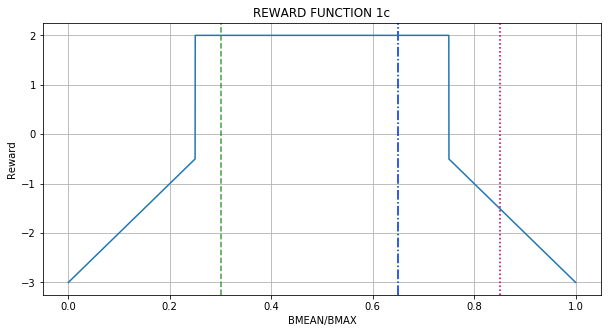

RF_1c(0)            =  -3.00
RF_1c(ENP_MARGIN/4) =  -3.00
RF_1c(ENP_MARGIN/2) =  -3.00
RF_1c(ENP_MARGIN)   =  -3.00

RF_1c(BMAX/2) =  -3.00
RF_1c(BMAX)   =  -3.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  AOMORI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -4.487
Day Violations           =    340
Battery Limit Violations =   3800
Action MEAN              =  5.026
Action STD DEV           =  2.187


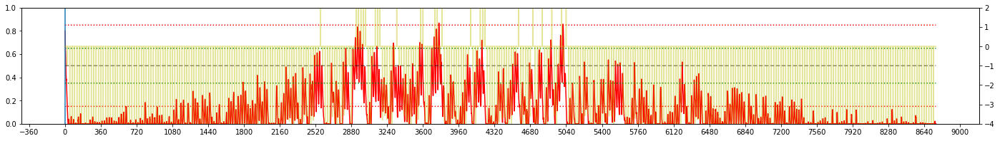


Iteration 1:  AOMORI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -4.096
Day Violations           =    320
Battery Limit Violations =   3690
Action MEAN              =  5.125
Action STD DEV           =  2.254


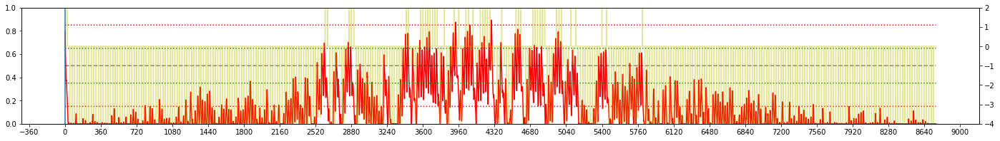


Iteration 2:  AOMORI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -4.231
Day Violations           =    330
Battery Limit Violations =   3604
Action MEAN              =  5.047
Action STD DEV           =  2.252


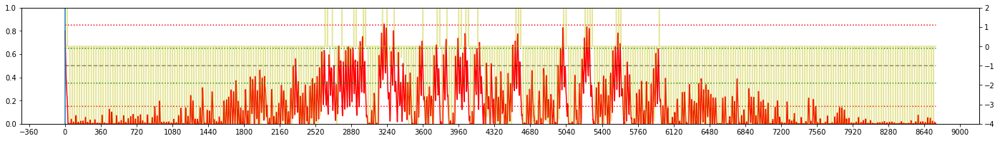


Iteration 3:  AOMORI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -4.497
Day Violations           =    340
Battery Limit Violations =   3950
Action MEAN              =  5.034
Action STD DEV           =  2.210


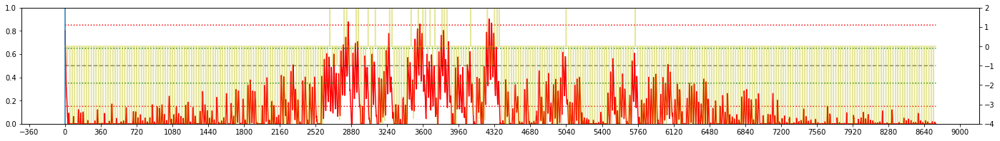


Iteration 4:  AOMORI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -4.226
Day Violations           =    328
Battery Limit Violations =   3757
Action MEAN              =  5.055
Action STD DEV           =  2.229


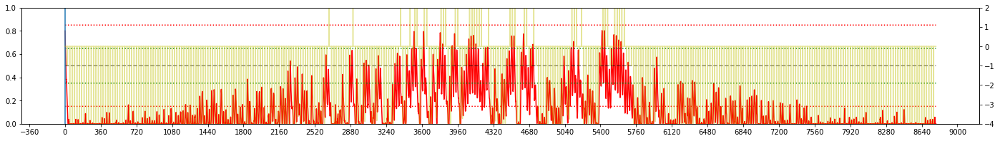


Iteration 5:  AOMORI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -4.424
Day Violations           =    338
Battery Limit Violations =   3754
Action MEAN              =  5.024
Action STD DEV           =  2.187


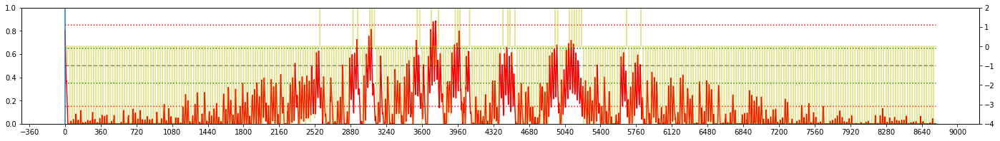


Iteration 6:  AOMORI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -4.418
Day Violations           =    335
Battery Limit Violations =   3770
Action MEAN              =  5.027
Action STD DEV           =  2.184


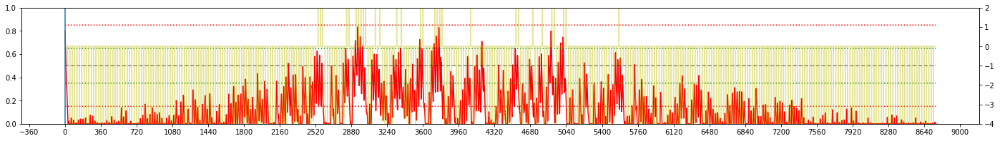


Iteration 7:  AOMORI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -4.391
Day Violations           =    333
Battery Limit Violations =   3743
Action MEAN              =  5.008
Action STD DEV           =  2.179


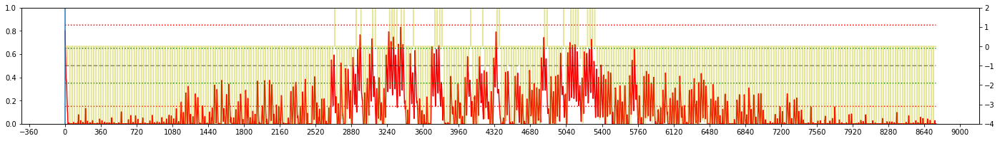


Iteration 8:  AOMORI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -4.442
Day Violations           =    341
Battery Limit Violations =   3761
Action MEAN              =  4.996
Action STD DEV           =  2.189


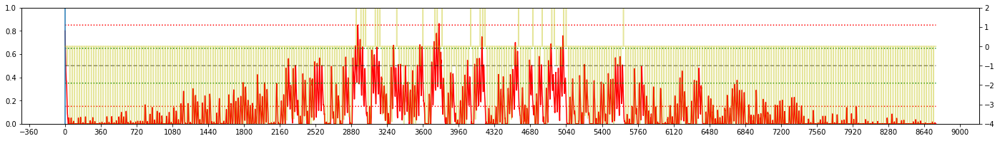


Iteration 9:  AOMORI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -4.427
Day Violations           =    336
Battery Limit Violations =   3770
Action MEAN              =  5.018
Action STD DEV           =  2.173


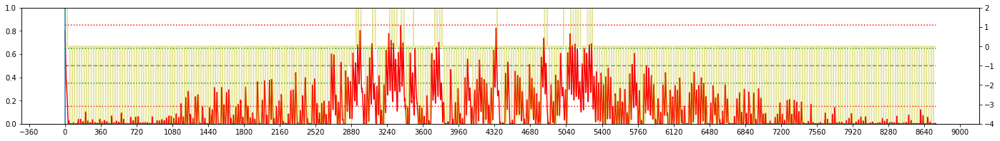


Iteration 10:  AOMORI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  = -4.149
Day Violations           =    330
Battery Limit Violations =   3445
Action MEAN              =  5.049
Action STD DEV           =  2.254


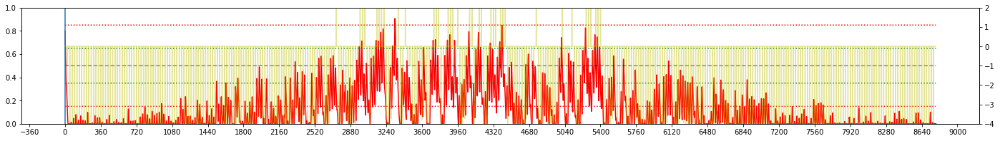


Iteration 11:  AOMORI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  = -4.104
Day Violations           =    322
Battery Limit Violations =   3624
Action MEAN              =  5.122
Action STD DEV           =  2.263


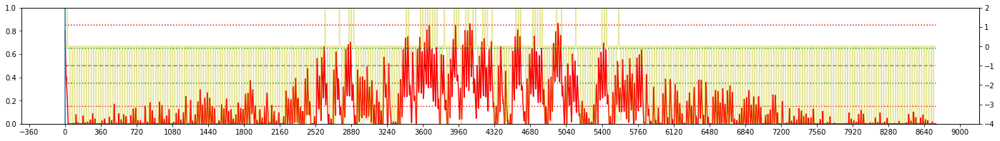


Iteration 12:  AOMORI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  = -4.271
Day Violations           =    328
Battery Limit Violations =   3776
Action MEAN              =  5.069
Action STD DEV           =  2.253


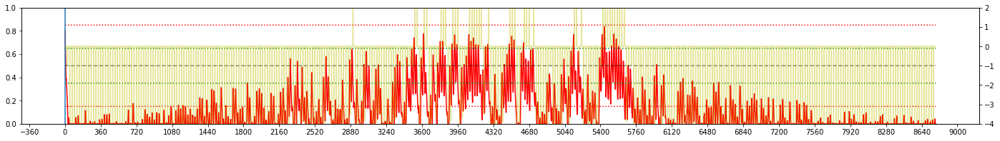


Iteration 13:  AOMORI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  = -4.417
Day Violations           =    333
Battery Limit Violations =   3855
Action MEAN              =  5.044
Action STD DEV           =  2.205


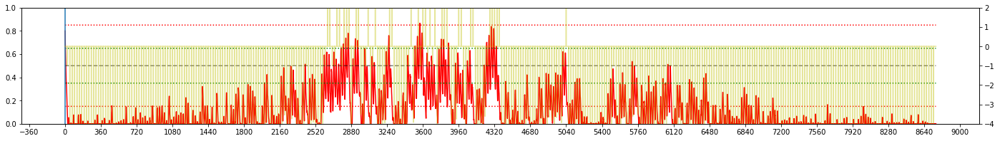


Iteration 14:  AOMORI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  = -4.442
Day Violations           =    338
Battery Limit Violations =   3871
Action MEAN              =  5.007
Action STD DEV           =  2.190


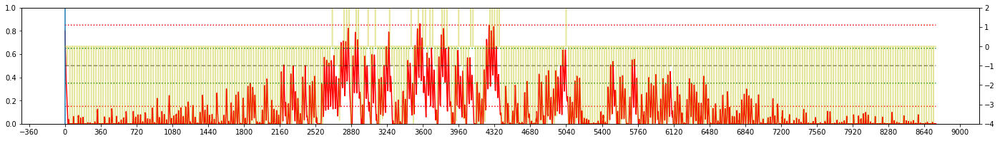


Iteration 15:  AOMORI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  = -3.966
Day Violations           =    318
Battery Limit Violations =   3495
Action MEAN              =  4.878
Action STD DEV           =  2.714


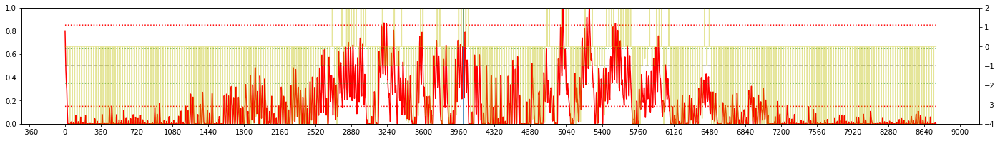


Iteration 16:  AOMORI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  = -4.149
Day Violations           =    332
Battery Limit Violations =   3216
Action MEAN              =  4.718
Action STD DEV           =  2.690


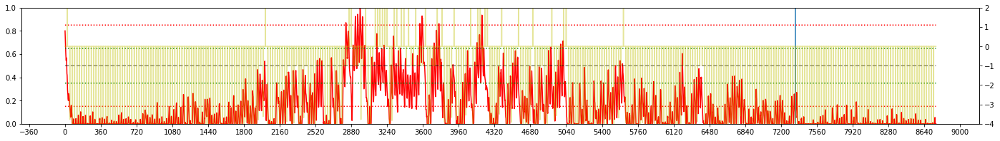


Iteration 17:  AOMORI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  = -2.494
Day Violations           =    245
Battery Limit Violations =   2435
Action MEAN              =  4.485
Action STD DEV           =  2.855


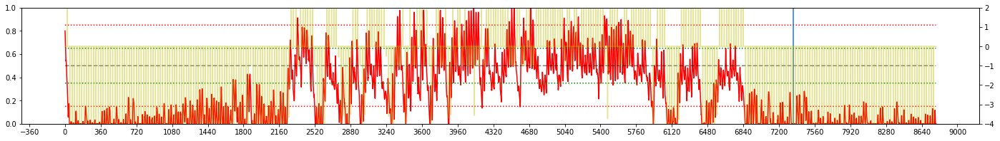


Iteration 18:  AOMORI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  = -1.096
Day Violations           =    165
Battery Limit Violations =   1838
Action MEAN              =  4.107
Action STD DEV           =  3.008


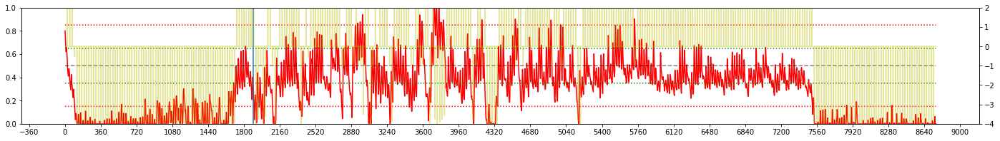


Iteration 19:  AOMORI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  = -0.703
Day Violations           =    149
Battery Limit Violations =   1545
Action MEAN              =  4.012
Action STD DEV           =  3.019


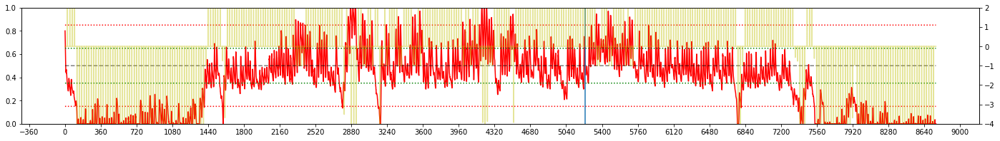


Iteration 20:  AOMORI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  = -0.829
Day Violations           =    154
Battery Limit Violations =   1526
Action MEAN              =  4.024
Action STD DEV           =  2.991


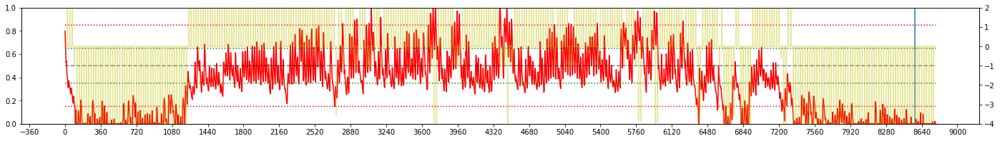


Iteration 21:  AOMORI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  = -0.281
Day Violations           =    122
Battery Limit Violations =   1531
Action MEAN              =  4.267
Action STD DEV           =  3.217


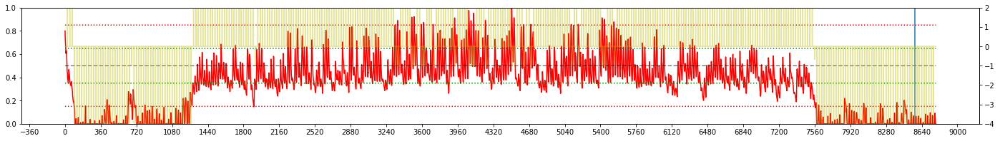


Iteration 22:  AOMORI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  =  0.124
Day Violations           =     98
Battery Limit Violations =   1127
Action MEAN              =  3.852
Action STD DEV           =  3.024


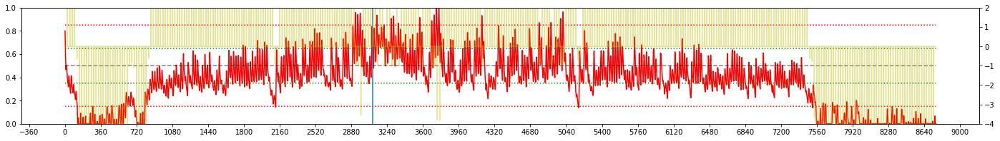


Iteration 23:  AOMORI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  = -0.236
Day Violations           =    113
Battery Limit Violations =   1586
Action MEAN              =  4.167
Action STD DEV           =  3.088


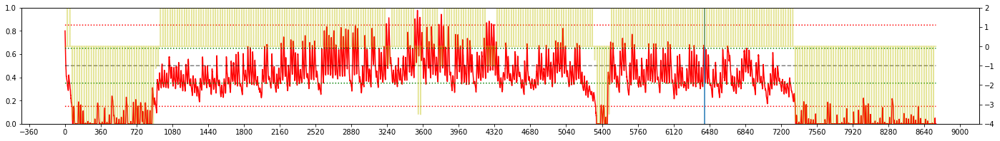


Iteration 24:  AOMORI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  = -0.159
Day Violations           =    108
Battery Limit Violations =   1493
Action MEAN              =  4.262
Action STD DEV           =  3.159


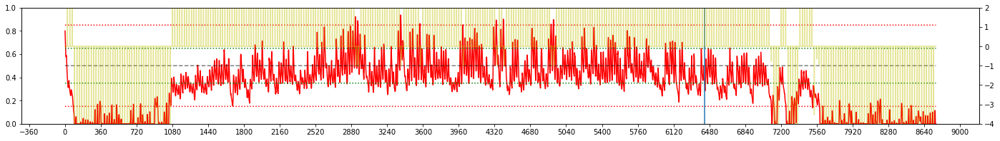


Iteration 25:  AOMORI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  =  0.104
Day Violations           =     96
Battery Limit Violations =   1236
Action MEAN              =  4.124
Action STD DEV           =  3.172


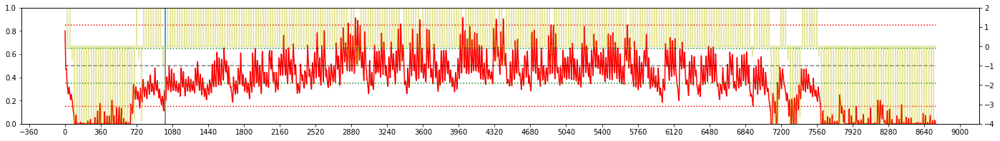


Iteration 26:  AOMORI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  = -0.196
Day Violations           =    112
Battery Limit Violations =   1438
Action MEAN              =  4.249
Action STD DEV           =  3.214


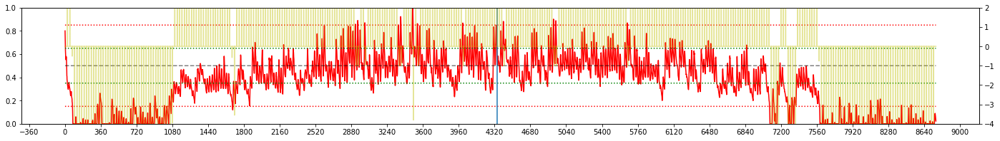


Iteration 27:  AOMORI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  = -0.118
Day Violations           =    115
Battery Limit Violations =   1562
Action MEAN              =  4.626
Action STD DEV           =  3.313


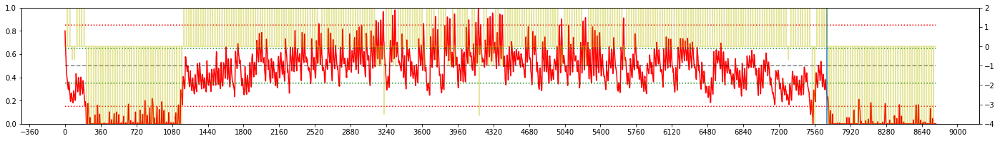


Iteration 28:  AOMORI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  = -0.288
Day Violations           =    118
Battery Limit Violations =   1663
Action MEAN              =  4.681
Action STD DEV           =  3.402


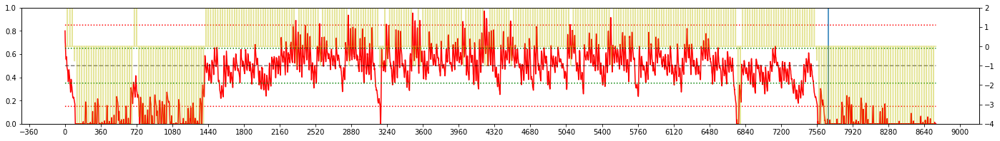


Iteration 29:  AOMORI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  = -0.254
Day Violations           =    118
Battery Limit Violations =   1601
Action MEAN              =  4.474
Action STD DEV           =  3.353


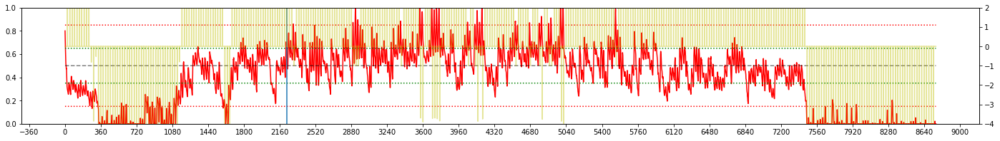


Iteration 30:  AOMORI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  = -0.302
Day Violations           =    120
Battery Limit Violations =   1493
Action MEAN              =  4.262
Action STD DEV           =  3.206


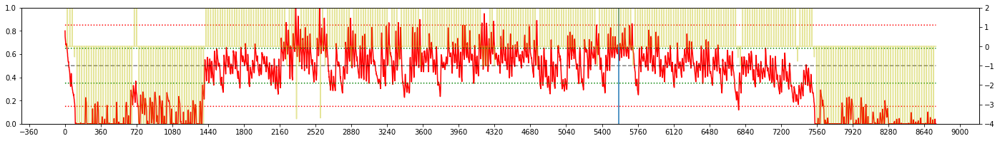


Iteration 31:  AOMORI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  = -0.232
Day Violations           =    115
Battery Limit Violations =   1473
Action MEAN              =  4.250
Action STD DEV           =  3.244


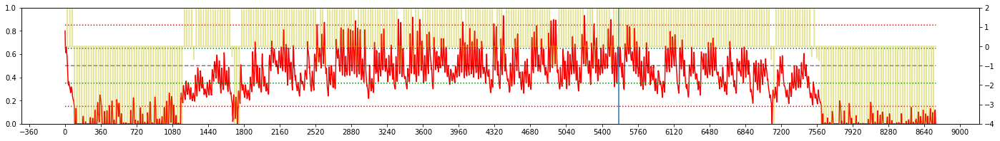


Iteration 32:  AOMORI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  = -0.386
Day Violations           =    121
Battery Limit Violations =   1868
Action MEAN              =  4.593
Action STD DEV           =  3.255


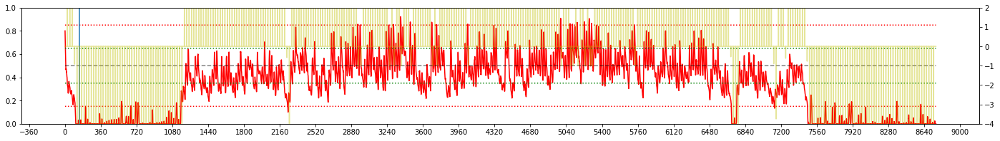


Iteration 33:  AOMORI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  = -0.265
Day Violations           =    116
Battery Limit Violations =   1488
Action MEAN              =  4.365
Action STD DEV           =  3.294


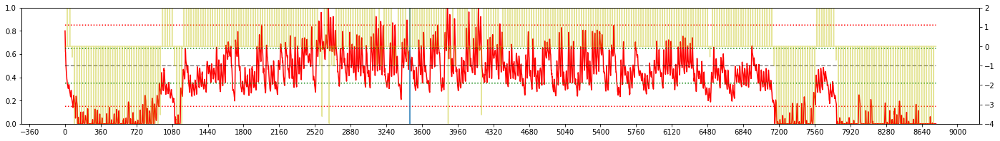


Iteration 34:  AOMORI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  = -0.024
Day Violations           =     95
Battery Limit Violations =   1614
Action MEAN              =  4.500
Action STD DEV           =  3.345


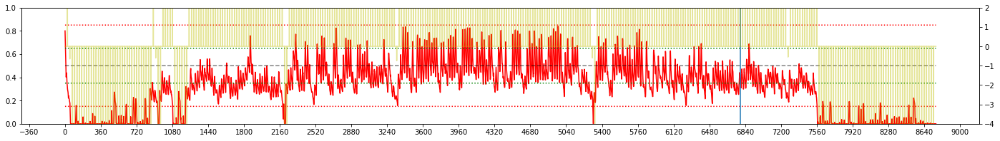


Iteration 35:  AOMORI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  = -0.243
Day Violations           =    107
Battery Limit Violations =   1812
Action MEAN              =  4.320
Action STD DEV           =  3.356


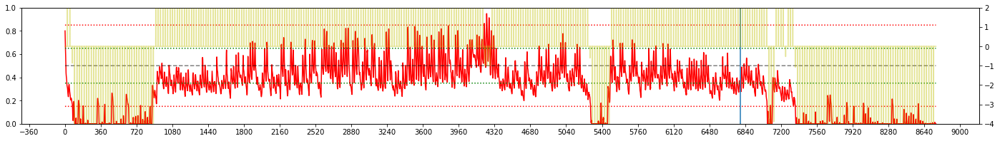


Iteration 36:  AOMORI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  =  0.045
Day Violations           =     91
Battery Limit Violations =   1492
Action MEAN              =  4.297
Action STD DEV           =  3.295


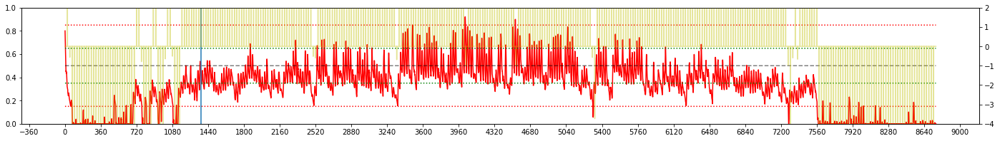


Iteration 37:  AOMORI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  = -0.304
Day Violations           =    110
Battery Limit Violations =   1836
Action MEAN              =  4.455
Action STD DEV           =  3.296


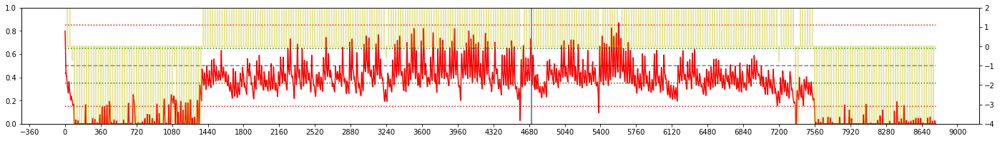


Iteration 38:  AOMORI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  = -0.063
Day Violations           =    101
Battery Limit Violations =   1535
Action MEAN              =  4.298
Action STD DEV           =  3.240


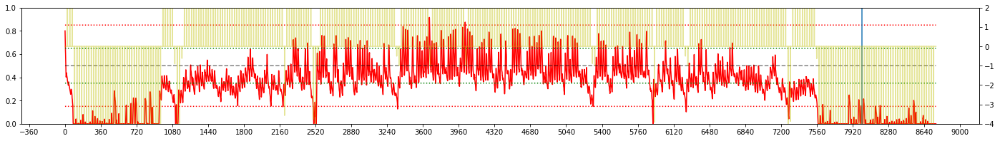


Iteration 39:  AOMORI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  =  0.200
Day Violations           =     92
Battery Limit Violations =   1162
Action MEAN              =  4.019
Action STD DEV           =  3.088


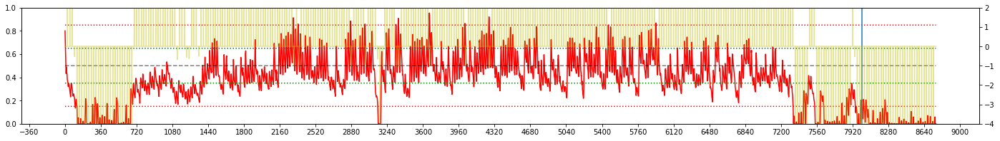


Iteration 40:  AOMORI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  = -0.537
Day Violations           =    131
Battery Limit Violations =   1422
Action MEAN              =  4.086
Action STD DEV           =  3.072


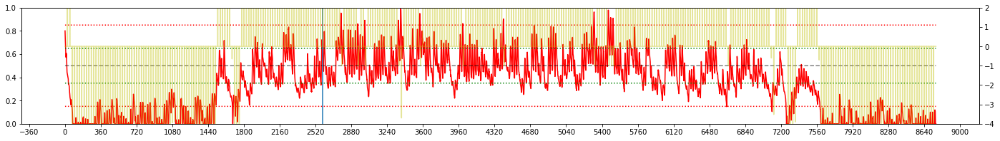


Iteration 41:  AOMORI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  =  0.004
Day Violations           =    119
Battery Limit Violations =   1014
Action MEAN              =  3.991
Action STD DEV           =  3.072


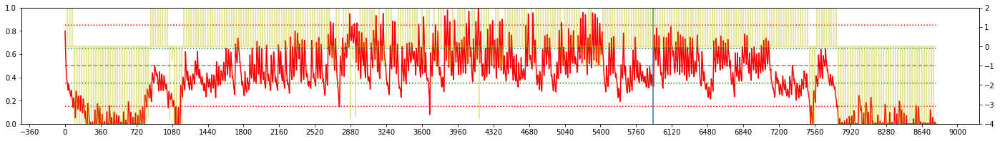


Iteration 42:  AOMORI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  =  0.008
Day Violations           =    106
Battery Limit Violations =   1247
Action MEAN              =  3.839
Action STD DEV           =  2.956


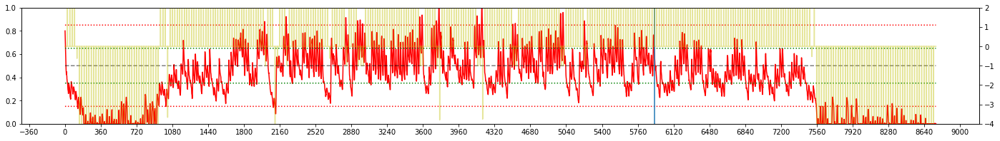


Iteration 43:  AOMORI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  = -0.356
Day Violations           =    126
Battery Limit Violations =   1347
Action MEAN              =  4.016
Action STD DEV           =  2.983


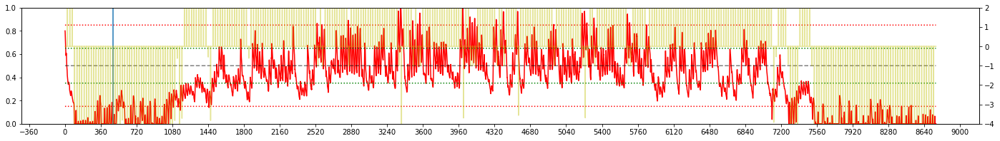


Iteration 44:  AOMORI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  = -0.260
Day Violations           =    121
Battery Limit Violations =   1417
Action MEAN              =  4.308
Action STD DEV           =  3.085


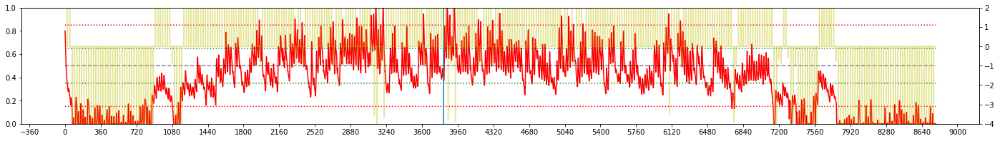


Iteration 45:  AOMORI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  = -0.126
Day Violations           =    110
Battery Limit Violations =   1538
Action MEAN              =  4.298
Action STD DEV           =  3.190


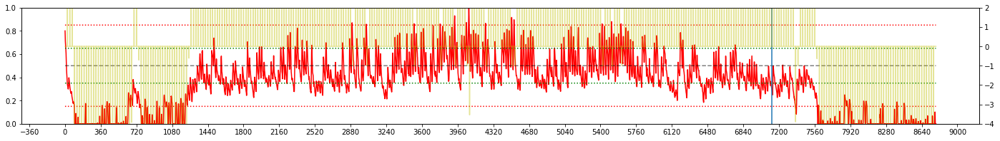


Iteration 46:  AOMORI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  = -0.163
Day Violations           =    110
Battery Limit Violations =   1620
Action MEAN              =  4.481
Action STD DEV           =  3.308


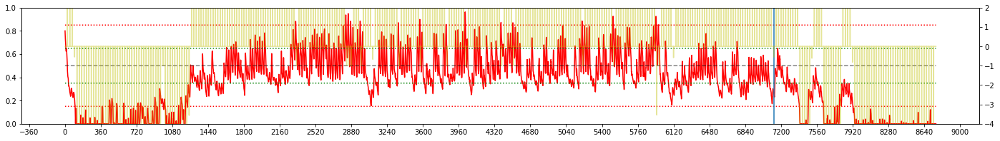


Iteration 47:  AOMORI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  0.136
Day Violations           =     95
Battery Limit Violations =   1134
Action MEAN              =  3.927
Action STD DEV           =  3.112


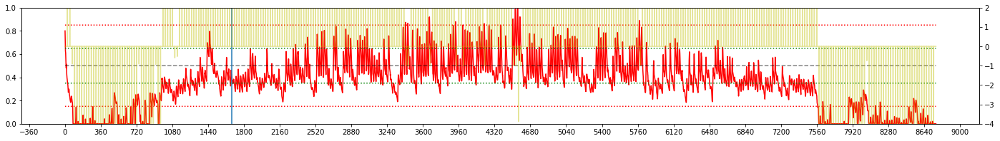


Iteration 48:  AOMORI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  = -0.326
Day Violations           =    113
Battery Limit Violations =   1576
Action MEAN              =  4.156
Action STD DEV           =  3.182


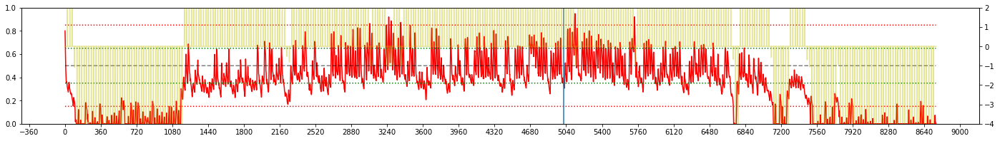


Iteration 49:  AOMORI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  =  0.223
Day Violations           =     87
Battery Limit Violations =   1306
Action MEAN              =  4.098
Action STD DEV           =  3.175


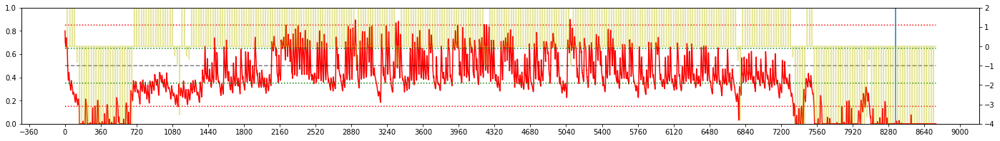


Iteration 50:  AOMORI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  0.255
Day Violations           =     90
Battery Limit Violations =   1126
Action MEAN              =  4.052
Action STD DEV           =  3.233


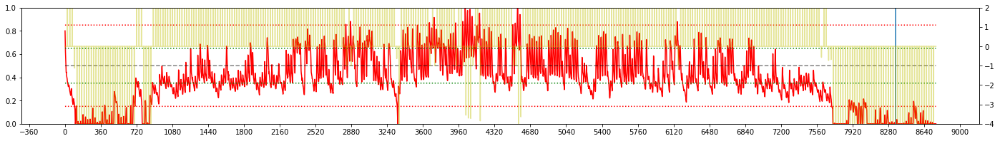


Iteration 51:  AOMORI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.212
Day Violations           =     89
Battery Limit Violations =   1412
Action MEAN              =  4.315
Action STD DEV           =  3.266


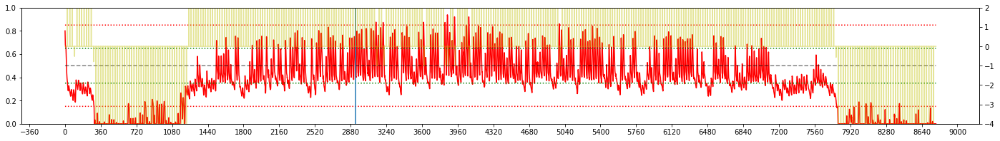


Iteration 52:  AOMORI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  = -0.147
Day Violations           =     99
Battery Limit Violations =   1812
Action MEAN              =  4.572
Action STD DEV           =  3.297


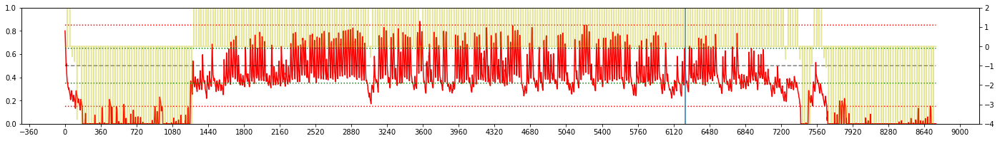


Iteration 53:  AOMORI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  =  0.194
Day Violations           =     86
Battery Limit Violations =   1558
Action MEAN              =  4.469
Action STD DEV           =  3.264


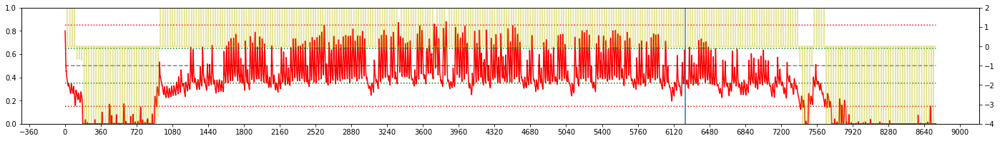


Iteration 54:  AOMORI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  =  0.603
Day Violations           =     68
Battery Limit Violations =   1080
Action MEAN              =  3.851
Action STD DEV           =  3.123


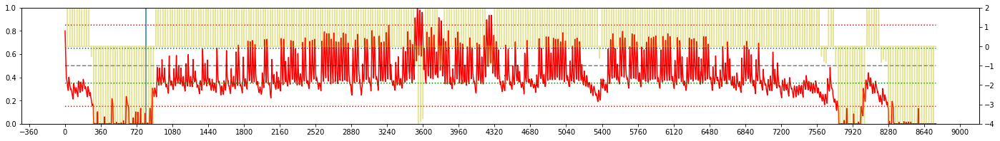


Iteration 55:  AOMORI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  1.098
Day Violations           =     44
Battery Limit Violations =    703
Action MEAN              =  3.630
Action STD DEV           =  3.051


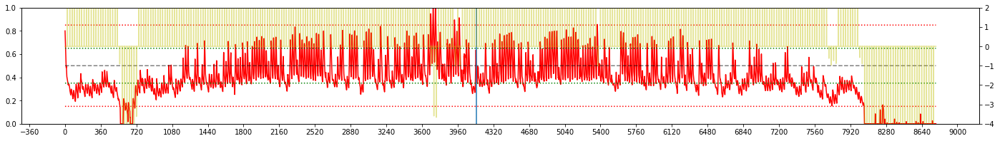


Iteration 56:  AOMORI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  0.905
Day Violations           =     58
Battery Limit Violations =    523
Action MEAN              =  3.566
Action STD DEV           =  3.039


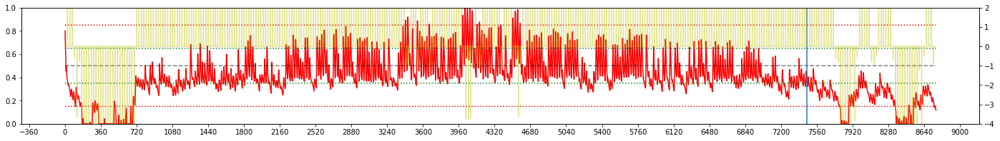


Iteration 57:  AOMORI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  1.514
Day Violations           =     27
Battery Limit Violations =    189
Action MEAN              =  3.456
Action STD DEV           =  2.881


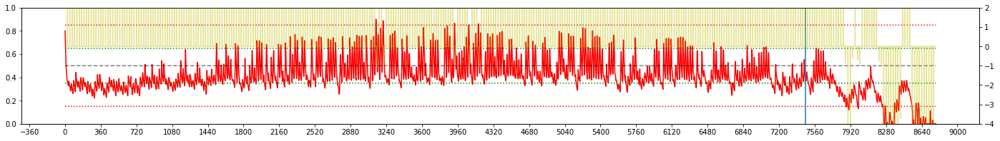


Iteration 58:  AOMORI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  1.070
Day Violations           =     45
Battery Limit Violations =    438
Action MEAN              =  3.599
Action STD DEV           =  2.961


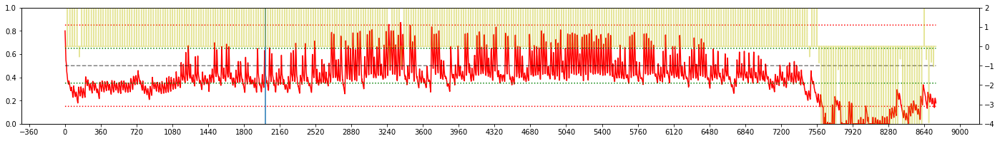


Iteration 59:  AOMORI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  1.117
Day Violations           =     45
Battery Limit Violations =     83
Action MEAN              =  3.253
Action STD DEV           =  2.813


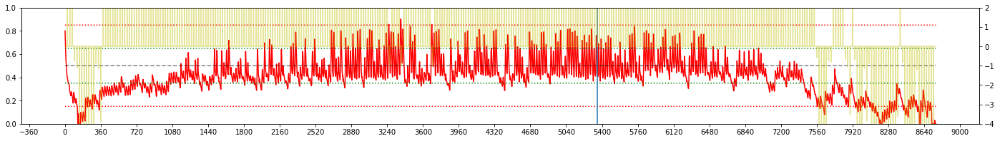


Iteration 60:  AOMORI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  1.545
Day Violations           =     26
Battery Limit Violations =     10
Action MEAN              =  3.200
Action STD DEV           =  2.806


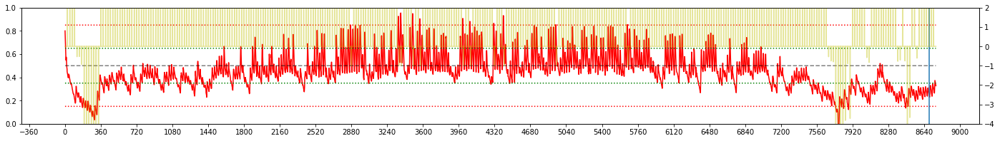


Iteration 61:  AOMORI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  =  1.353
Day Violations           =     38
Battery Limit Violations =     59
Action MEAN              =  3.256
Action STD DEV           =  2.887


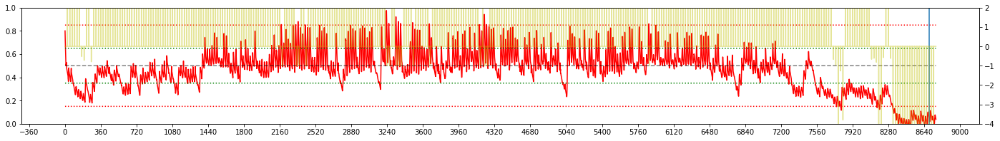


Iteration 62:  AOMORI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  1.113
Day Violations           =     53
Battery Limit Violations =     10
Action MEAN              =  3.196
Action STD DEV           =  2.942


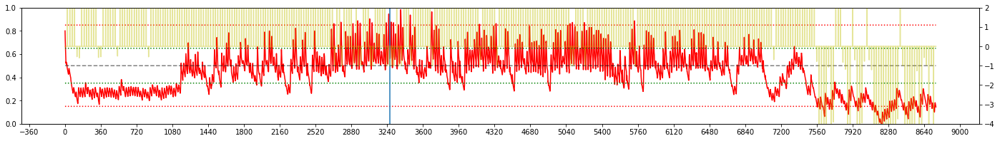


Iteration 63:  AOMORI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  1.055
Day Violations           =     53
Battery Limit Violations =     57
Action MEAN              =  3.194
Action STD DEV           =  2.924


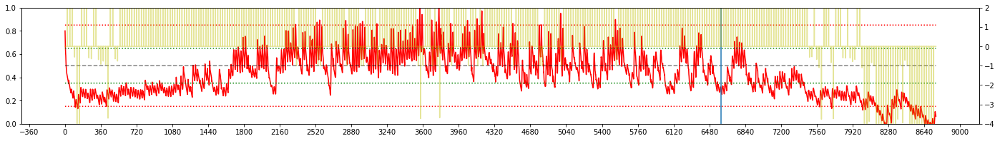


Iteration 64:  AOMORI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  1.221
Day Violations           =     40
Battery Limit Violations =     19
Action MEAN              =  3.192
Action STD DEV           =  2.998


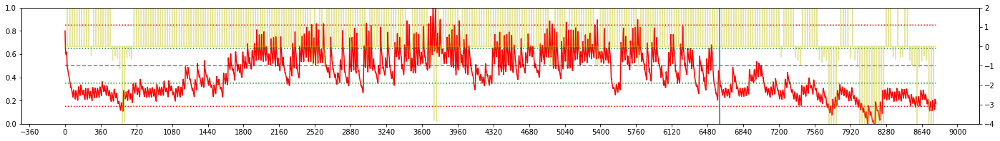


Iteration 65:  AOMORI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  1.050
Day Violations           =     52
Battery Limit Violations =    132
Action MEAN              =  3.357
Action STD DEV           =  3.189


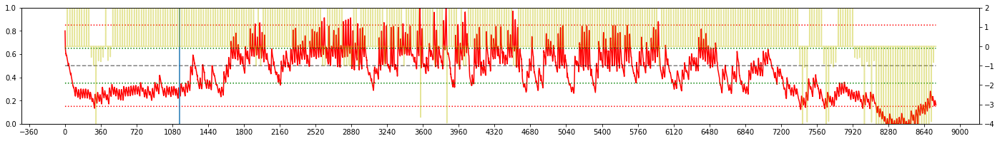


Iteration 66:  AOMORI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.814
Day Violations           =     65
Battery Limit Violations =     51
Action MEAN              =  3.248
Action STD DEV           =  3.210


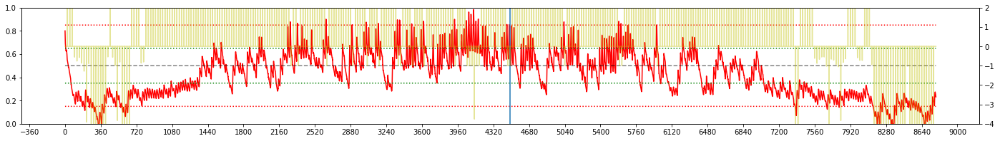


Iteration 67:  AOMORI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  1.097
Day Violations           =     42
Battery Limit Violations =    121
Action MEAN              =  3.223
Action STD DEV           =  3.230


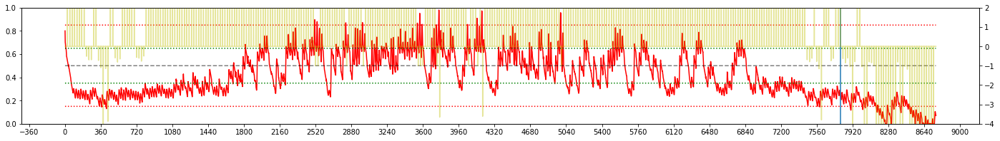


Iteration 68:  AOMORI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  0.766
Day Violations           =     65
Battery Limit Violations =    222
Action MEAN              =  3.271
Action STD DEV           =  3.358


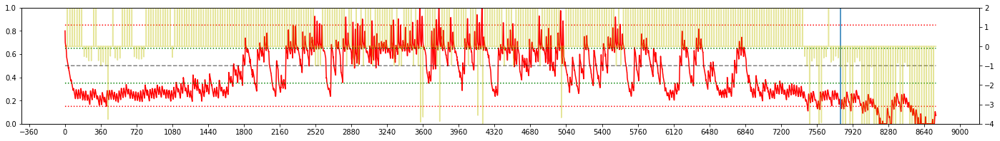


Iteration 69:  AOMORI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.379
Day Violations           =     89
Battery Limit Violations =    425
Action MEAN              =  3.439
Action STD DEV           =  3.310


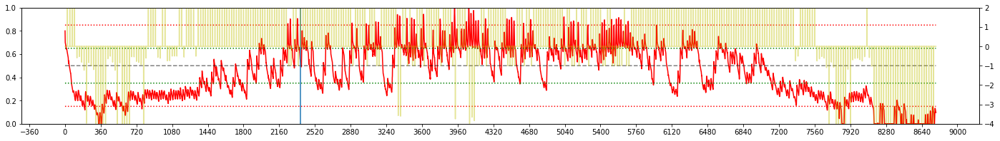


Iteration 70:  AOMORI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.736
Day Violations           =     82
Battery Limit Violations =    249
Action MEAN              =  3.332
Action STD DEV           =  3.334


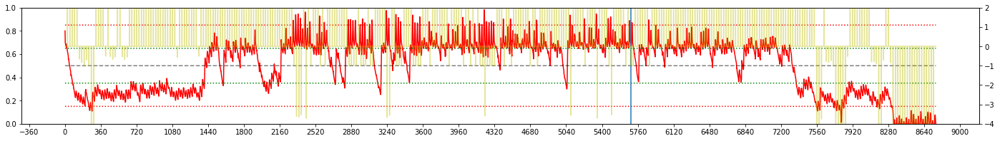


Iteration 71:  AOMORI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  0.378
Day Violations           =    101
Battery Limit Violations =    121
Action MEAN              =  3.363
Action STD DEV           =  3.400


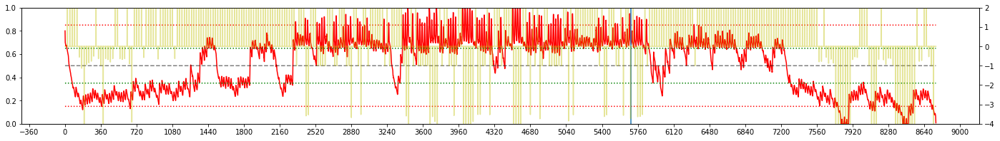


Iteration 72:  AOMORI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  0.401
Day Violations           =    105
Battery Limit Violations =    100
Action MEAN              =  3.218
Action STD DEV           =  3.382


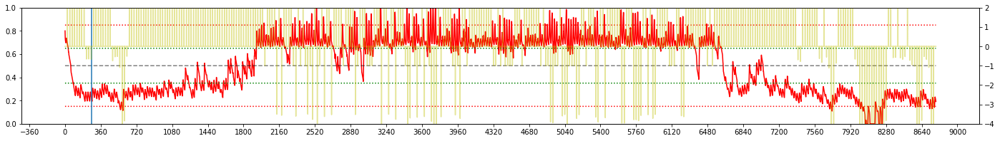


Iteration 73:  AOMORI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  0.085
Day Violations           =    115
Battery Limit Violations =    402
Action MEAN              =  3.312
Action STD DEV           =  3.345


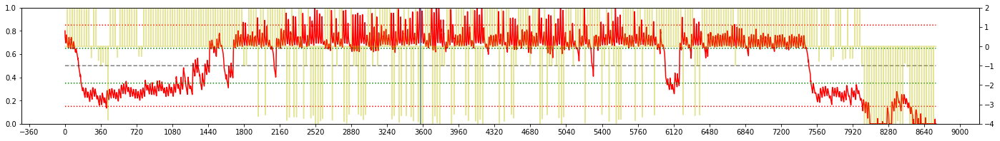


Iteration 74:  AOMORI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  0.212
Day Violations           =    103
Battery Limit Violations =     85
Action MEAN              =  3.208
Action STD DEV           =  3.413


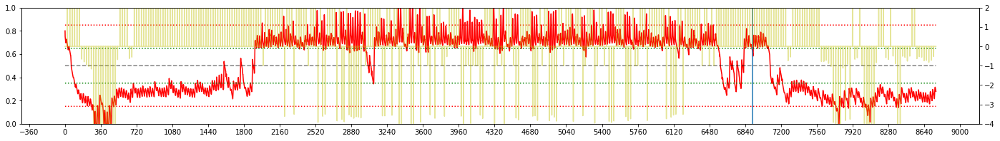


Iteration 75:  AOMORI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  = -0.151
Day Violations           =    128
Battery Limit Violations =    501
Action MEAN              =  3.388
Action STD DEV           =  3.435


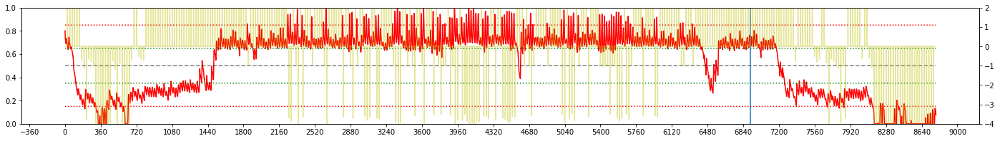


Iteration 76:  AOMORI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  = -0.213
Day Violations           =    123
Battery Limit Violations =    533
Action MEAN              =  3.449
Action STD DEV           =  3.428


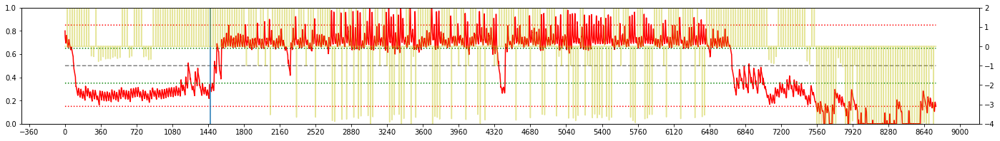


Iteration 77:  AOMORI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  0.086
Day Violations           =    112
Battery Limit Violations =    360
Action MEAN              =  3.399
Action STD DEV           =  3.382


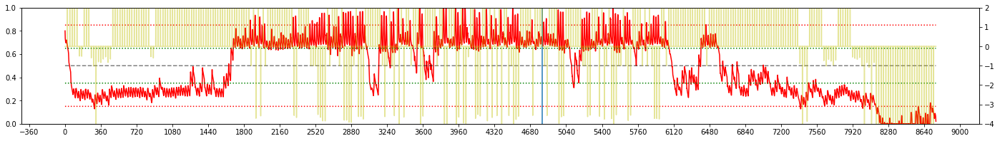


Iteration 78:  AOMORI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  0.471
Day Violations           =     91
Battery Limit Violations =    147
Action MEAN              =  3.433
Action STD DEV           =  3.414


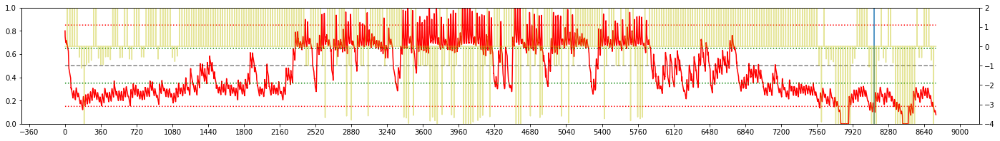


Iteration 79:  AOMORI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  1.073
Day Violations           =     57
Battery Limit Violations =     46
Action MEAN              =  3.215
Action STD DEV           =  3.162


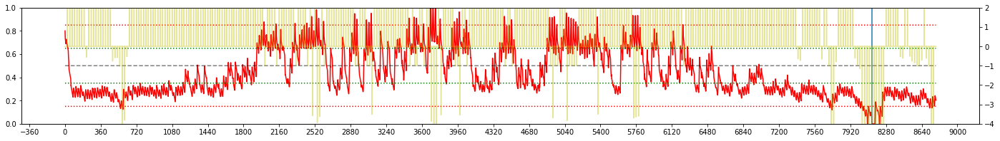


Iteration 80:  AOMORI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  1.252
Day Violations           =     40
Battery Limit Violations =     26
Action MEAN              =  3.198
Action STD DEV           =  3.027


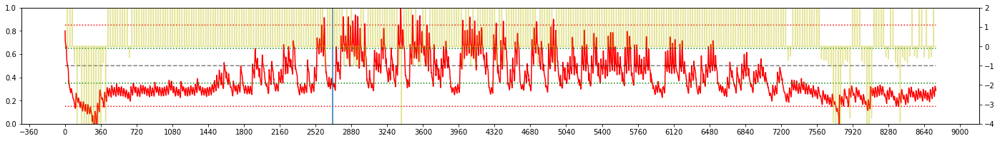


Iteration 81:  AOMORI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  1.411
Day Violations           =     23
Battery Limit Violations =     11
Action MEAN              =  3.196
Action STD DEV           =  2.904


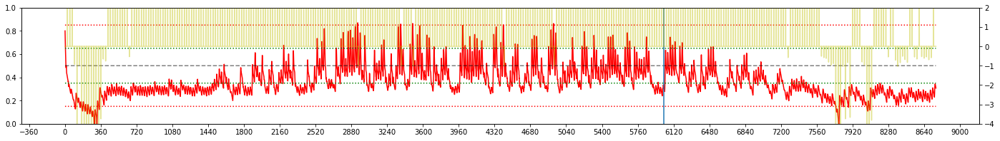


Iteration 82:  AOMORI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  1.185
Day Violations           =     38
Battery Limit Violations =    203
Action MEAN              =  3.341
Action STD DEV           =  2.904


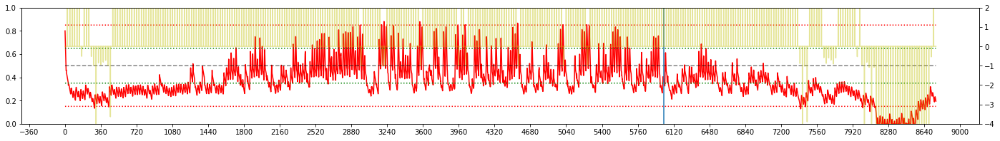


Iteration 83:  AOMORI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  1.146
Day Violations           =     39
Battery Limit Violations =     22
Action MEAN              =  3.200
Action STD DEV           =  2.844


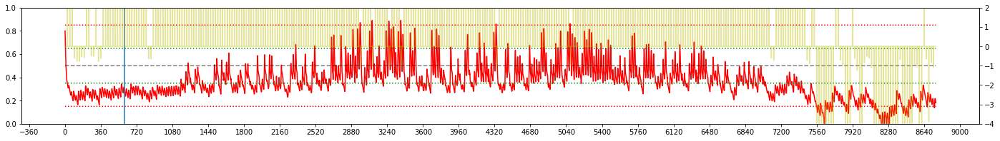


Iteration 84:  AOMORI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  1.290
Day Violations           =     34
Battery Limit Violations =    170
Action MEAN              =  3.414
Action STD DEV           =  2.951


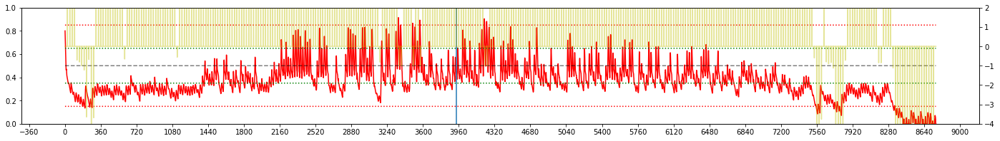


Iteration 85:  AOMORI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  1.212
Day Violations           =     39
Battery Limit Violations =    188
Action MEAN              =  3.369
Action STD DEV           =  2.949


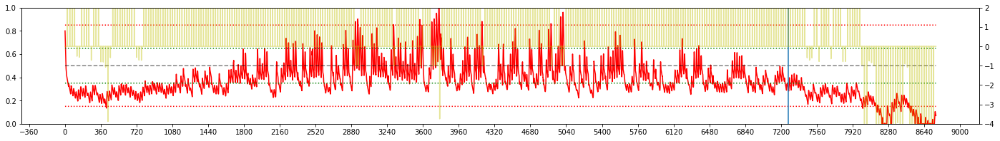


Iteration 86:  AOMORI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  1.251
Day Violations           =     39
Battery Limit Violations =    188
Action MEAN              =  3.366
Action STD DEV           =  2.943


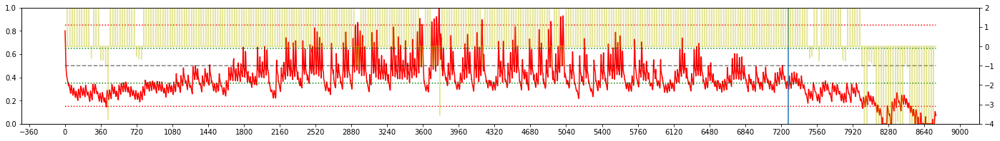


Iteration 87:  AOMORI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  1.015
Day Violations           =     54
Battery Limit Violations =    108
Action MEAN              =  3.334
Action STD DEV           =  2.915


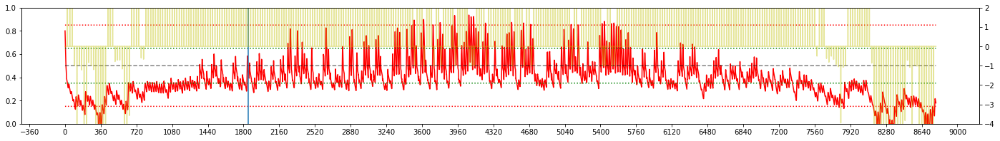


Iteration 88:  AOMORI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  1.312
Day Violations           =     33
Battery Limit Violations =     15
Action MEAN              =  3.204
Action STD DEV           =  2.797


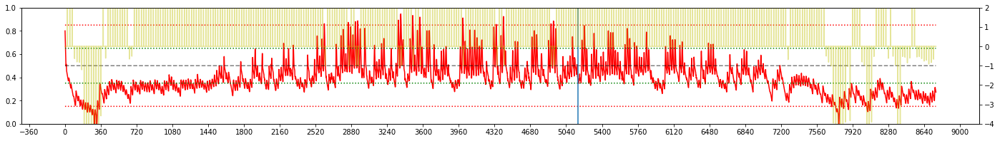


Iteration 89:  AOMORI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  1.249
Day Violations           =     36
Battery Limit Violations =    370
Action MEAN              =  3.431
Action STD DEV           =  2.758


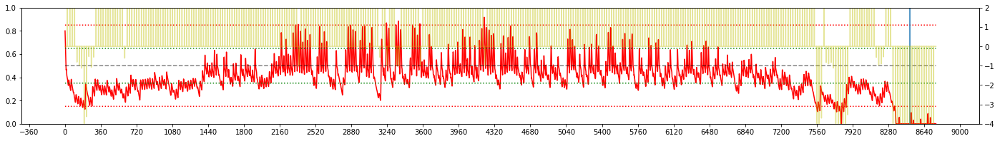


Iteration 90:  AOMORI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  0.971
Day Violations           =     45
Battery Limit Violations =    150
Action MEAN              =  3.471
Action STD DEV           =  2.979


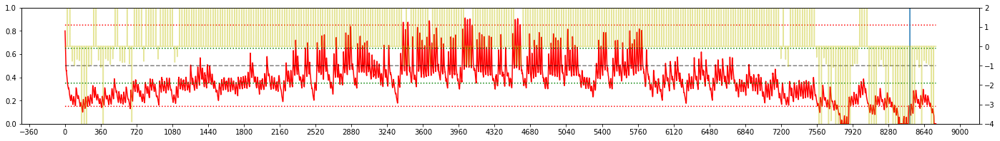


Iteration 91:  AOMORI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  1.039
Day Violations           =     38
Battery Limit Violations =     99
Action MEAN              =  3.298
Action STD DEV           =  2.808


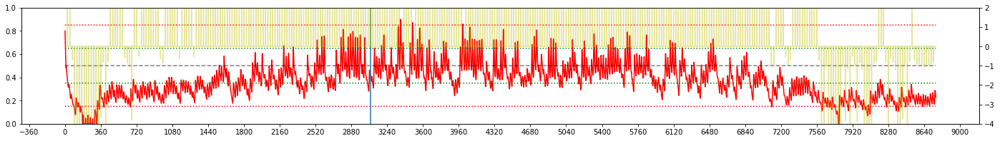


Iteration 92:  AOMORI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  1.314
Day Violations           =     24
Battery Limit Violations =     27
Action MEAN              =  3.215
Action STD DEV           =  2.948


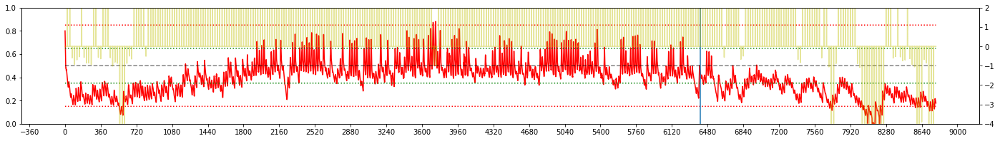


Iteration 93:  AOMORI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  1.227
Day Violations           =     33
Battery Limit Violations =    246
Action MEAN              =  3.550
Action STD DEV           =  3.253


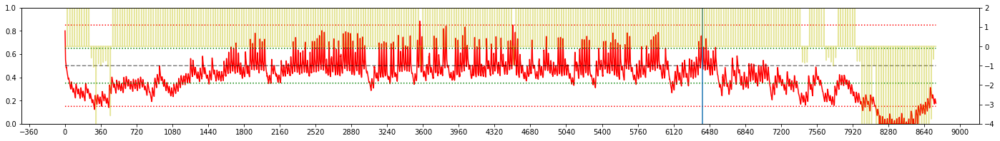


Iteration 94:  AOMORI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  1.284
Day Violations           =     27
Battery Limit Violations =     16
Action MEAN              =  3.239
Action STD DEV           =  3.019


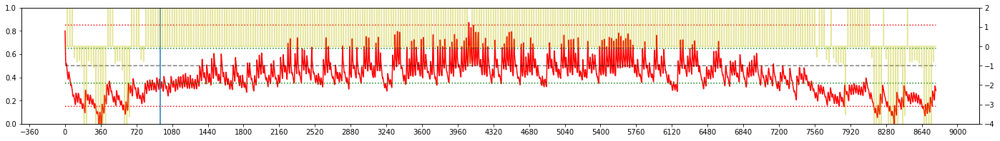


Iteration 95:  AOMORI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  1.571
Day Violations           =     20
Battery Limit Violations =      0
Action MEAN              =  3.375
Action STD DEV           =  3.093


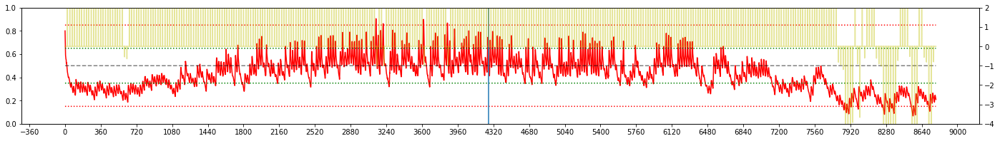


Iteration 96:  AOMORI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  1.621
Day Violations           =     15
Battery Limit Violations =      0
Action MEAN              =  3.191
Action STD DEV           =  2.977


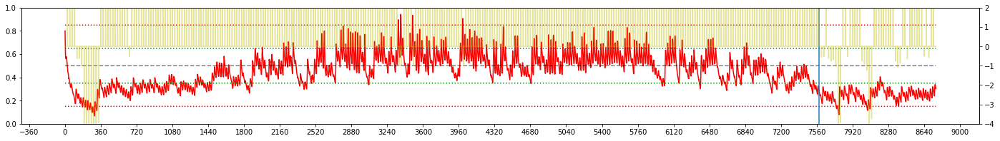


Iteration 97:  AOMORI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  1.520
Day Violations           =     17
Battery Limit Violations =      0
Action MEAN              =  3.194
Action STD DEV           =  3.017


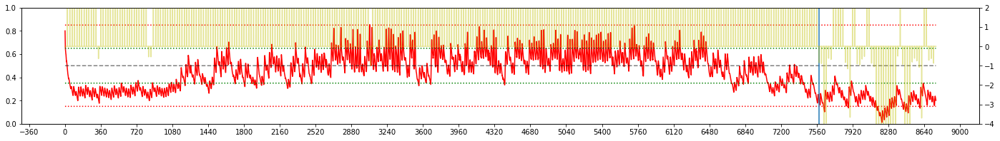


Iteration 98:  AOMORI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  1.360
Day Violations           =     28
Battery Limit Violations =      0
Action MEAN              =  3.123
Action STD DEV           =  2.987


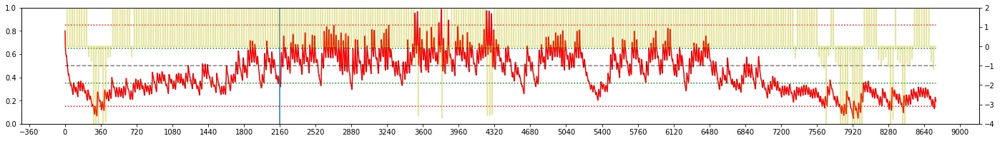


Iteration 99:  AOMORI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  1.260
Day Violations           =     37
Battery Limit Violations =      0
Action MEAN              =  3.226
Action STD DEV           =  3.096


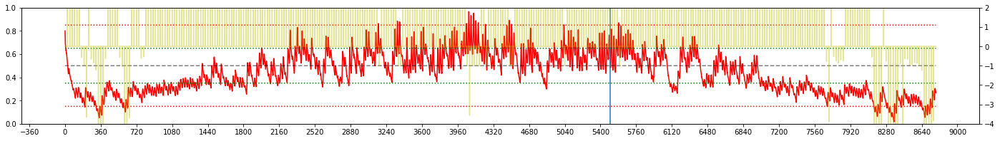

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'aomori'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset(batt=0.8*capm.BMAX)
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.good_memory_counter > MEMORY_CAPACITY and dqn.bad_memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:23:51.817643



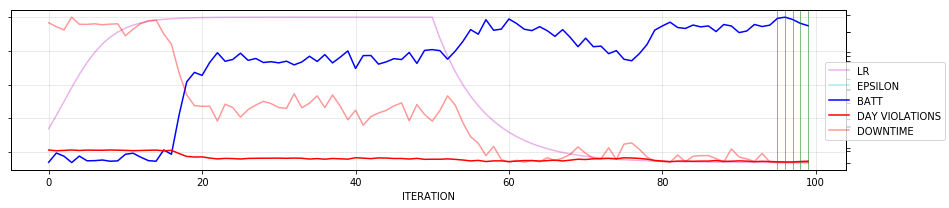

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_D_aomori_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


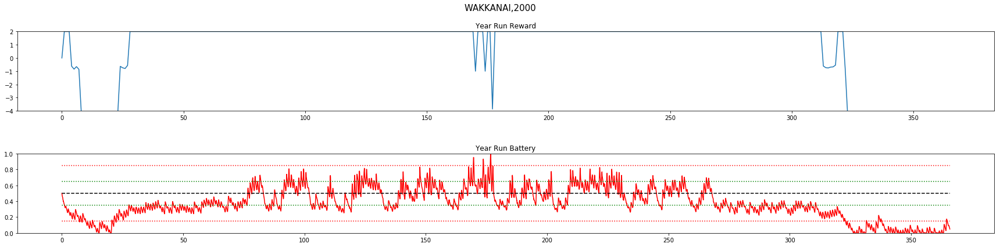

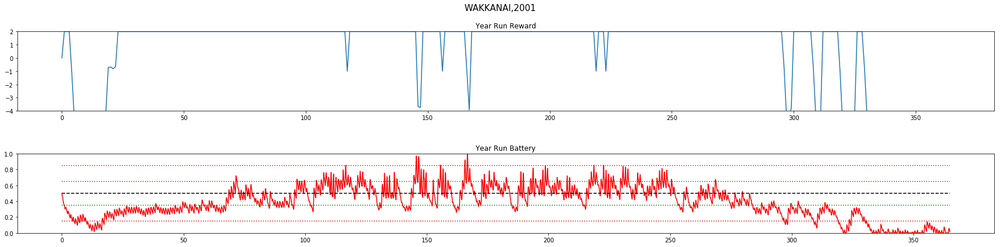

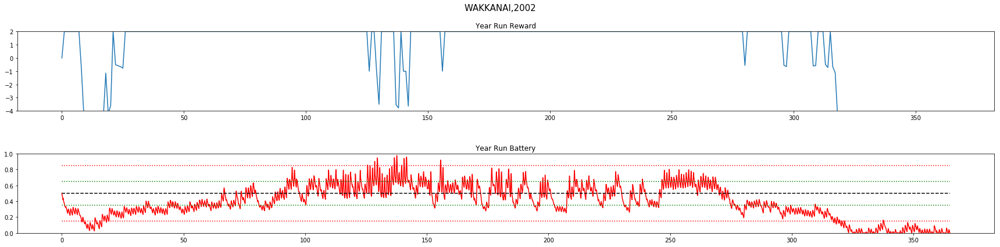

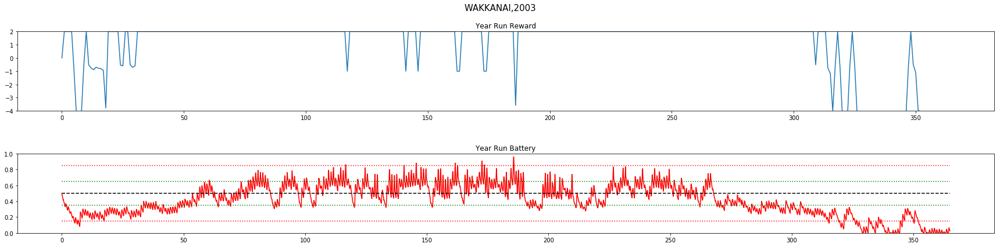

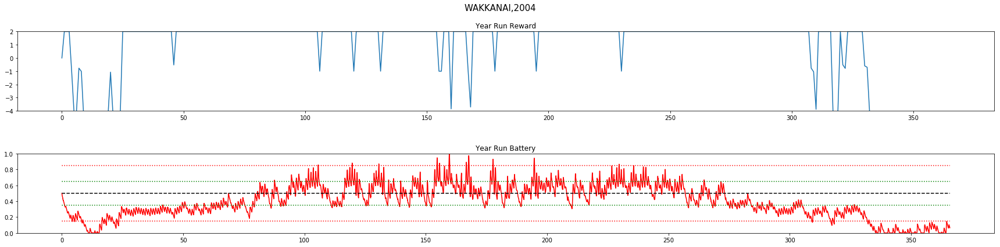

...

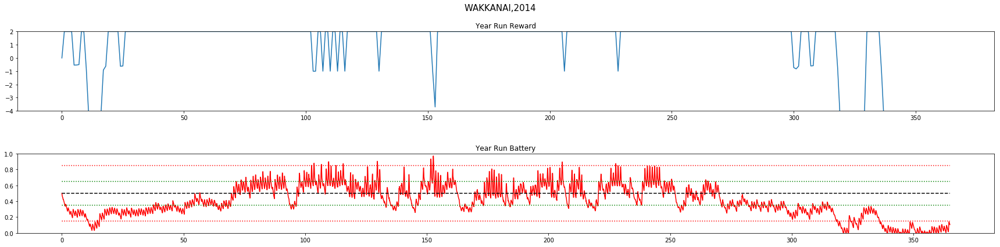

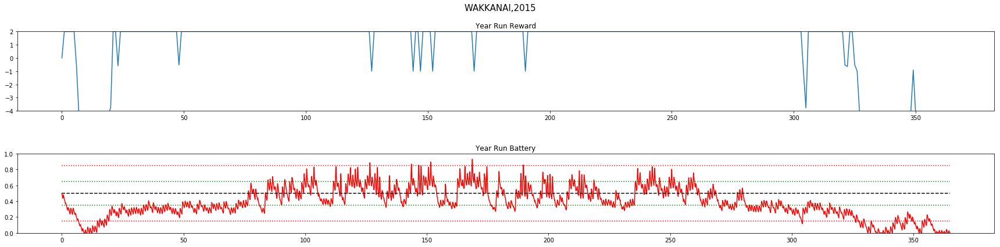

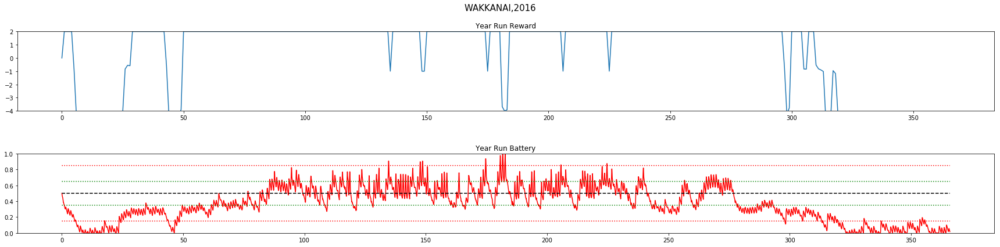

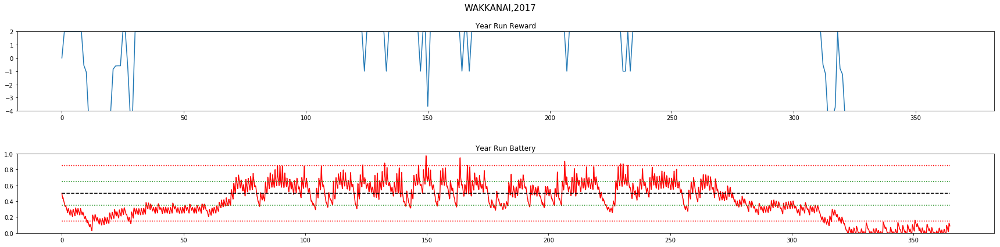

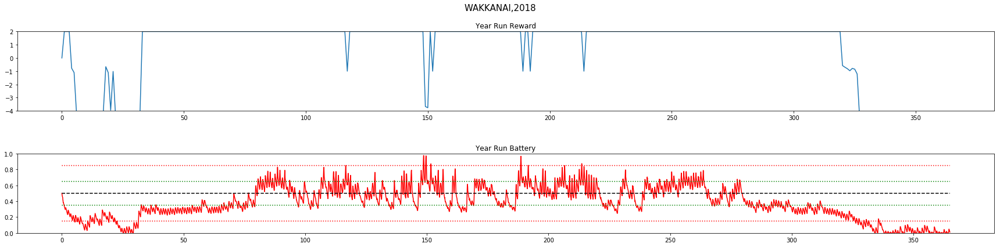



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.66		63	 260
2001	 0.62		70	 327
2002	 0.6		68	 317
2003	 0.9		52	 182
2004	 0.71		67	 314
2005	 0.8		59	 106
2006	 0.7		64	 237
2007	 0.8		59	 264
2008	 0.54		72	 268
2009	 0.45		77	 184
2010	 0.65		62	 251
2011	 0.77		60	 301
2012	 0.57		69	 376
2013	 0.55		73	 258
2014	 0.88		57	 160
2015	 0.86		59	 172
2016	 0.23		88	 290
2017	 0.62		71	 291
2018	 0.59		70	 279

TOTAL Day Violations:   1260.0
TOTAL Batt Violations:  4837.0
************************************


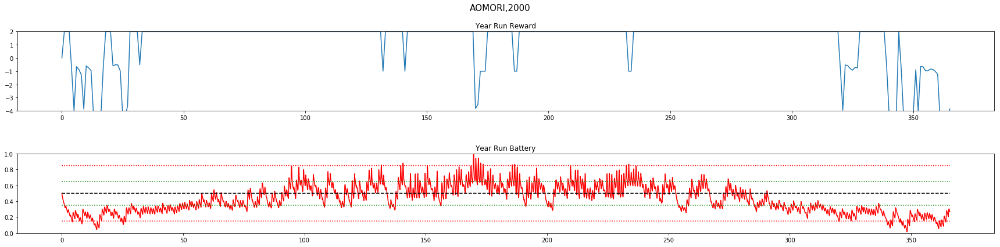

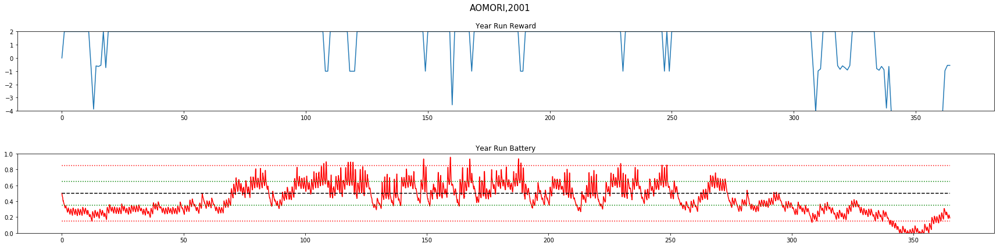

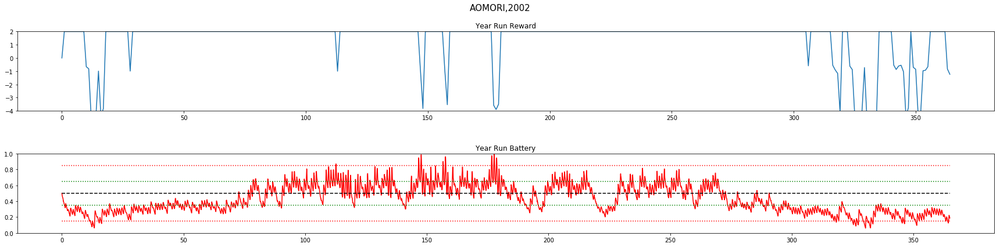

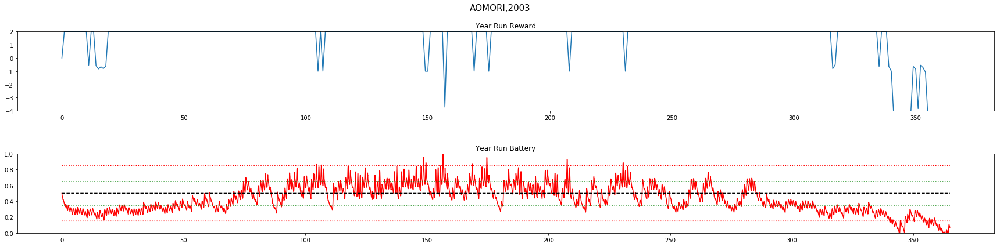

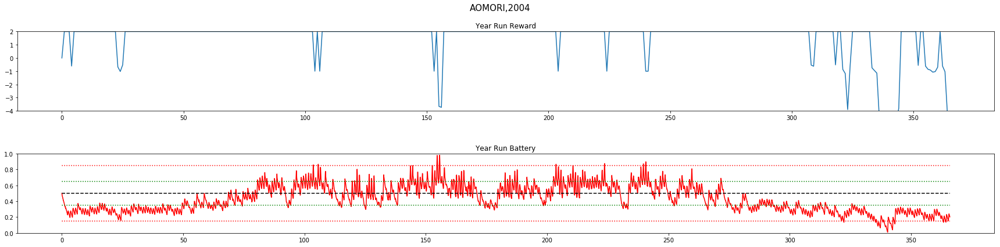

...

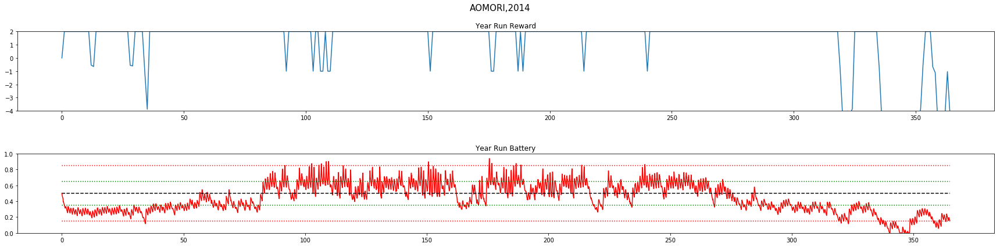

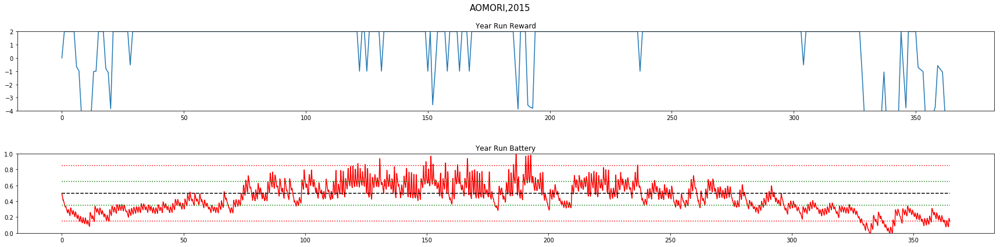

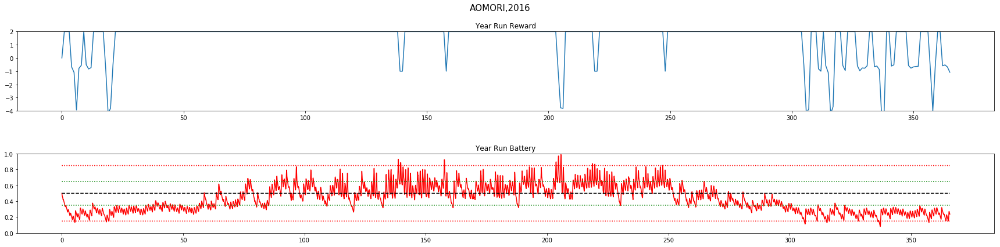

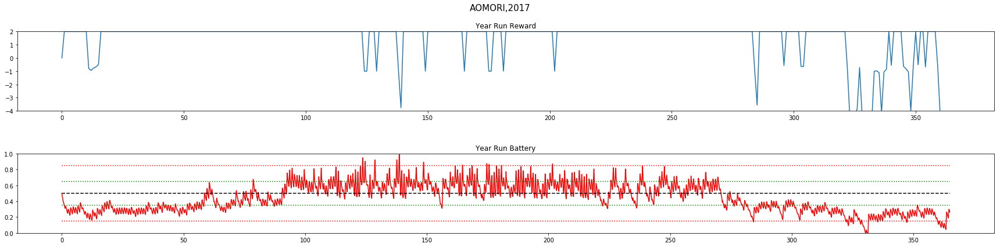

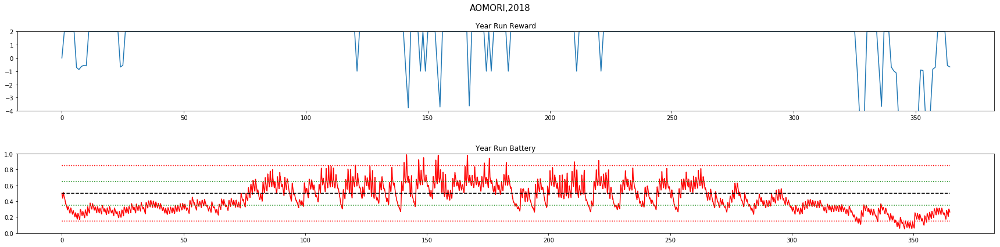



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.21		36	 0
2001	 1.23		38	 71
2002	 1.38		28	 0
2003	 1.43		29	 32
2004	 1.52		21	 0
2005	 1.55		20	 1
2006	 1.41		24	 4
2007	 1.36		31	 0
2008	 1.54		23	 0
2009	 1.35		34	 33
2010	 1.37		30	 24
2011	 1.23		39	 61
2012	 1.19		44	 0
2013	 1.49		22	 0
2014	 1.29		42	 52
2015	 1.17		46	 17
2016	 1.47		20	 0
2017	 1.41		28	 10
2018	 1.44		29	 0

TOTAL Day Violations:   584.0
TOTAL Batt Violations:  305.0
************************************


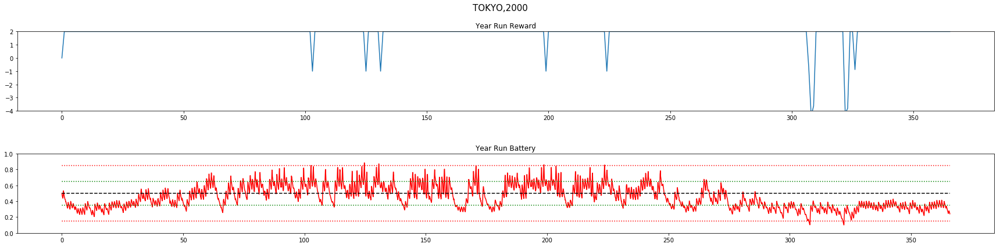

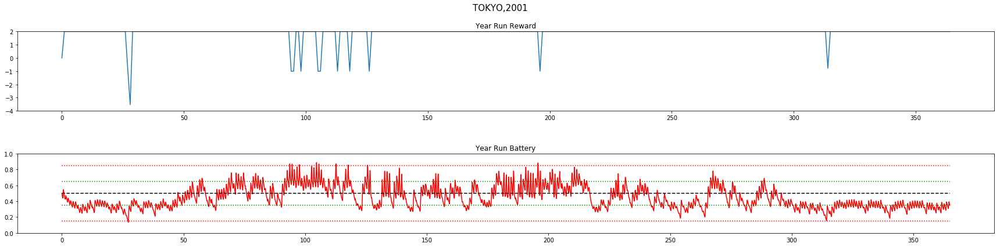

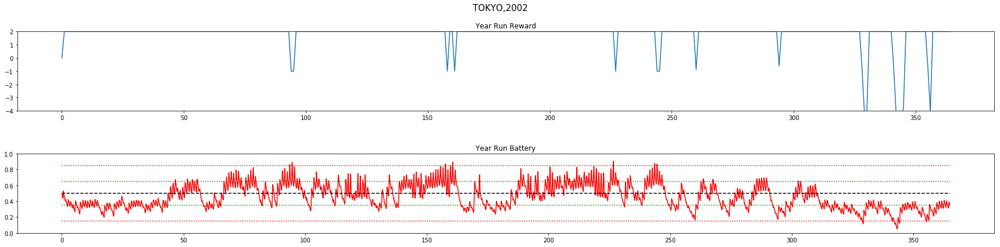

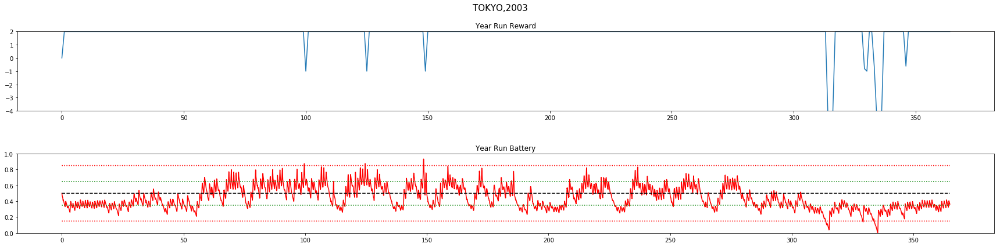

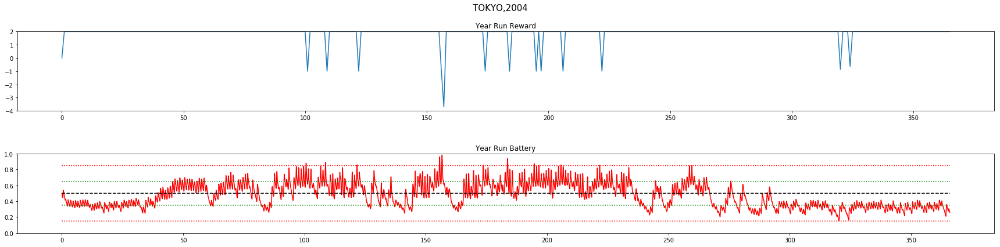

...

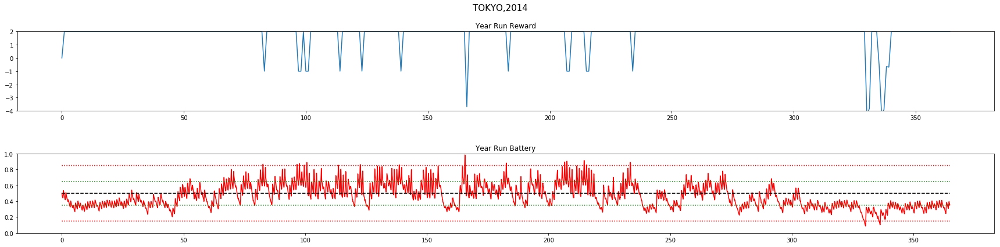

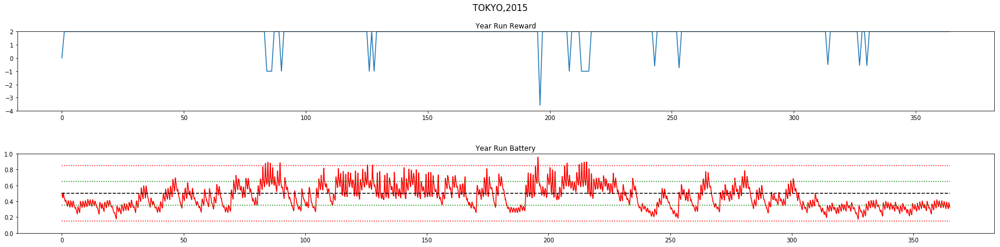

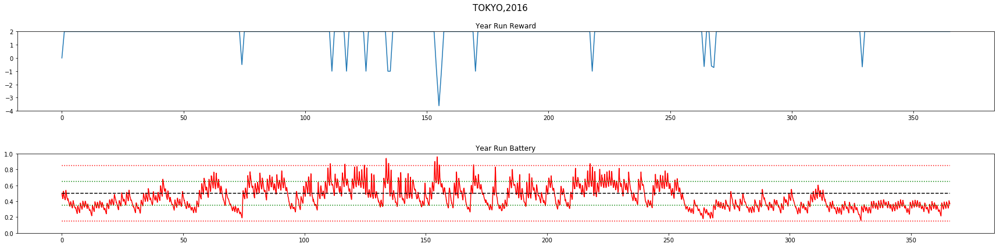

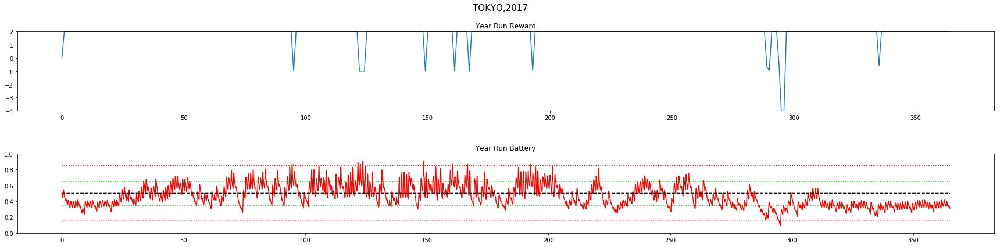

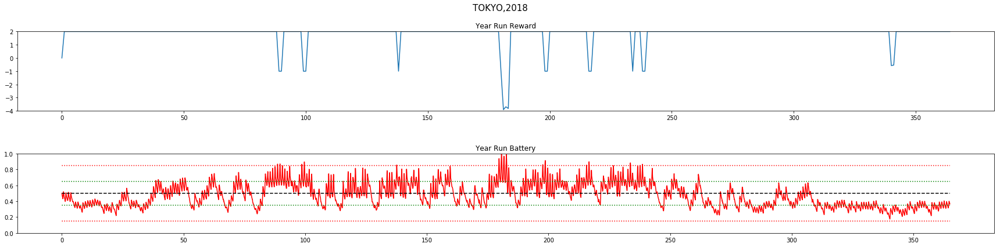



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.87		9	 0
2001	 1.89		10	 0
2002	 1.78		14	 0
2003	 1.83		10	 0
2004	 1.88		11	 0
2005	 1.87		11	 0
2006	 1.88		8	 0
2007	 1.88		12	 0
2008	 1.87		12	 0
2009	 1.84		9	 0
2010	 1.78		17	 0
2011	 1.82		19	 0
2012	 1.81		18	 0
2013	 1.91		9	 0
2014	 1.78		19	 0
2015	 1.85		12	 0
2016	 1.87		10	 0
2017	 1.87		10	 0
2018	 1.83		16	 0

TOTAL Day Violations:   236.0
TOTAL Batt Violations:  0.0
************************************


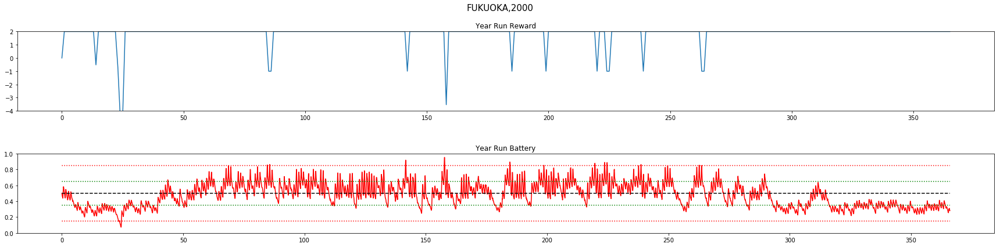

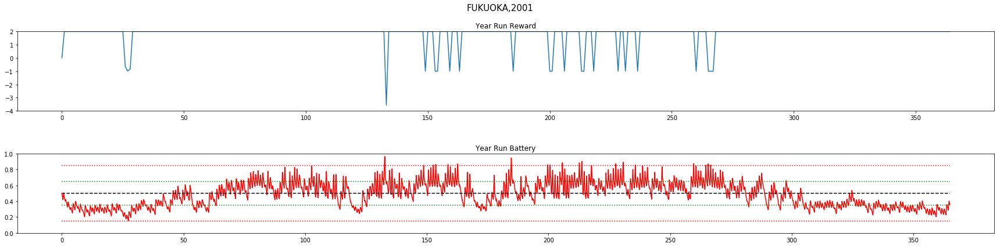

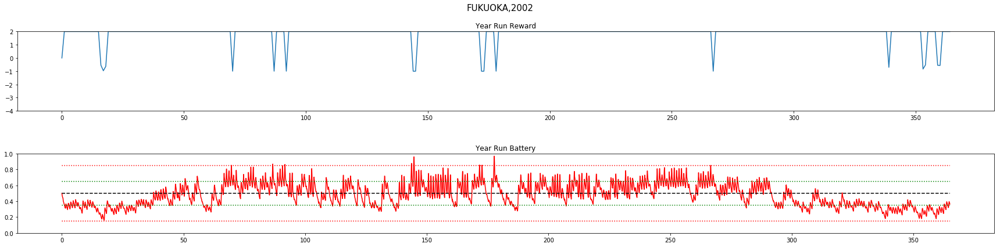

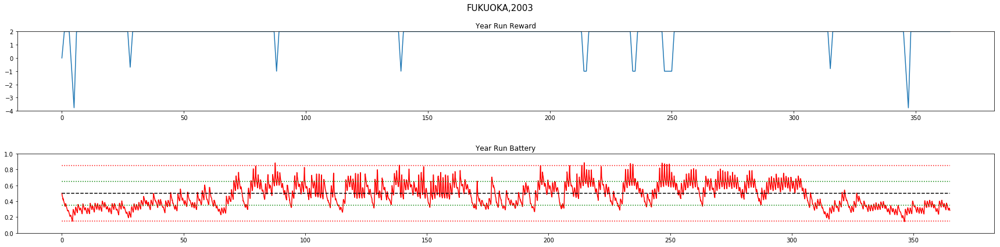

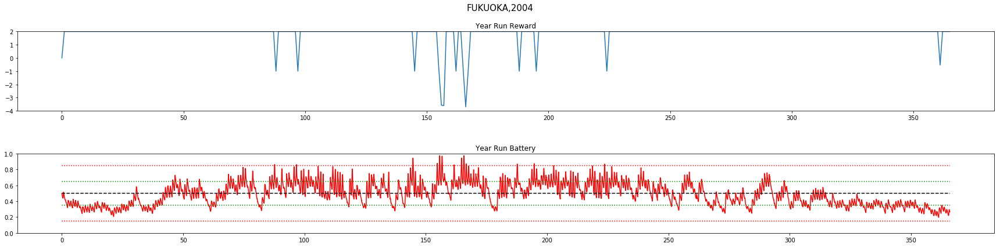

...

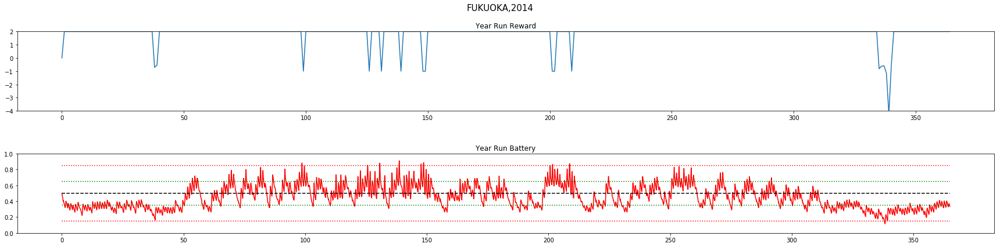

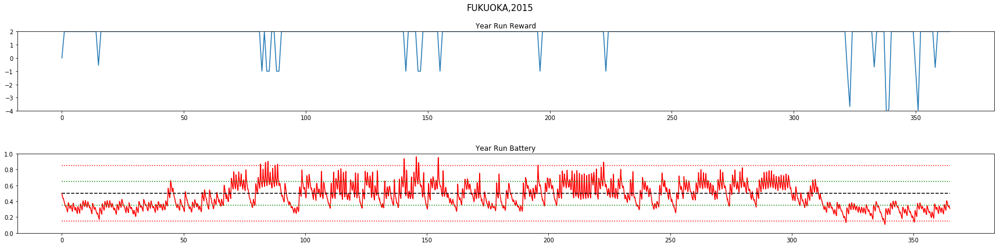

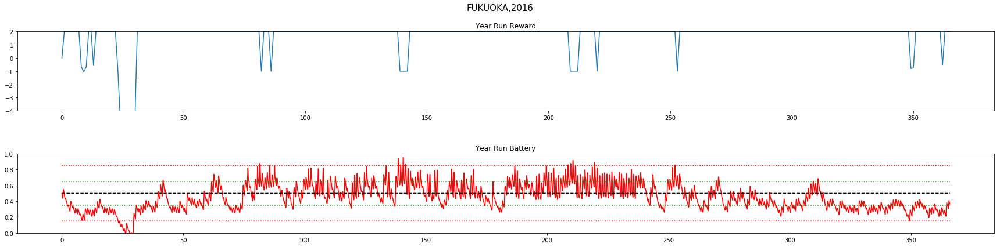

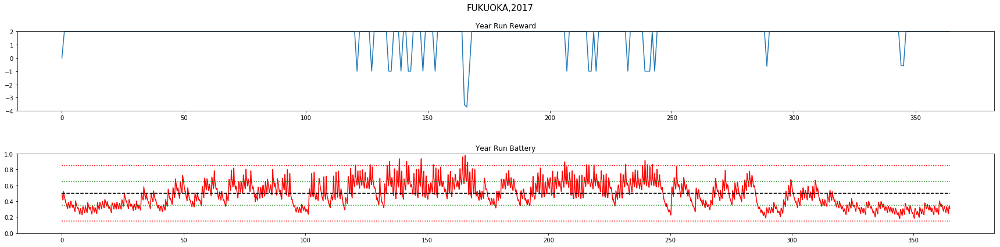

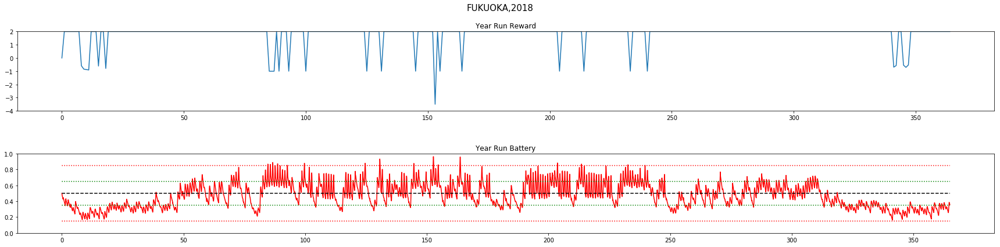



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.84		14	 0
2001	 1.8		20	 0
2002	 1.86		9	 0
2003	 1.85		12	 0
2004	 1.86		13	 0
2005	 1.9		11	 0
2006	 1.81		12	 0
2007	 1.78		18	 0
2008	 1.89		7	 0
2009	 1.75		19	 0
2010	 1.72		25	 0
2011	 1.76		16	 0
2012	 1.85		12	 0
2013	 1.84		13	 0
2014	 1.85		10	 0
2015	 1.8		15	 0
2016	 1.7		19	 32
2017	 1.79		21	 0
2018	 1.77		16	 0

TOTAL Day Violations:   282.0
TOTAL Batt Violations:  32.0
************************************


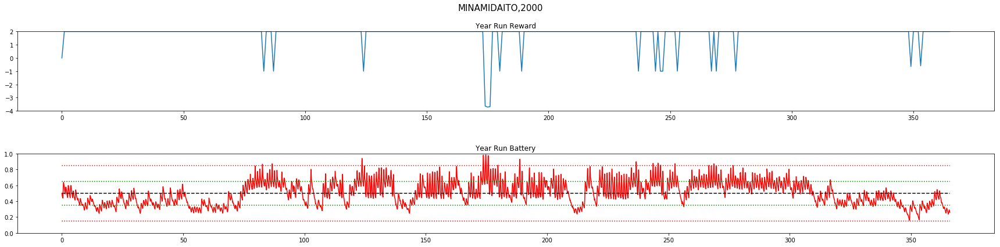

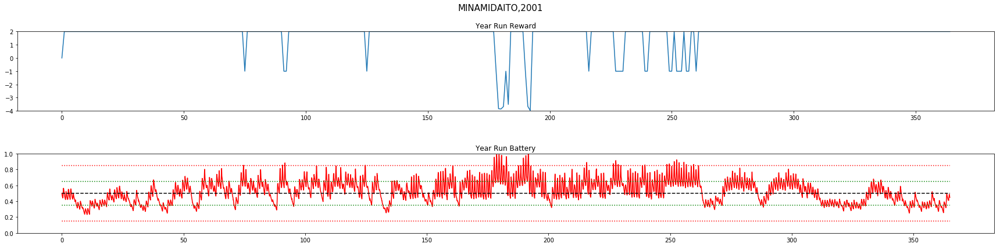

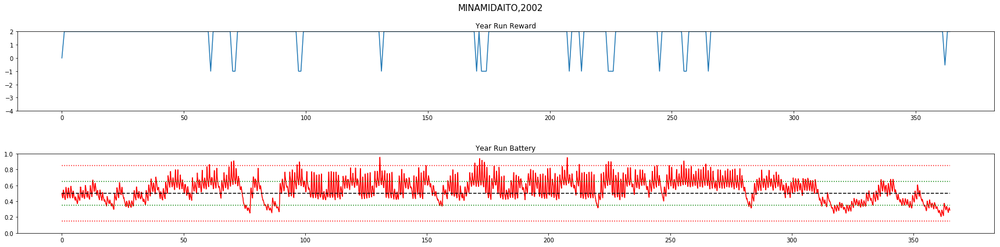

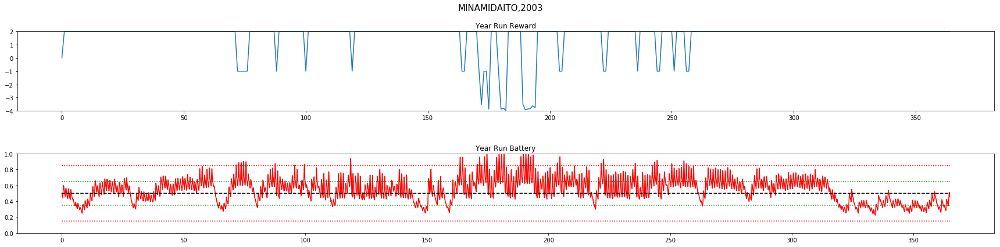

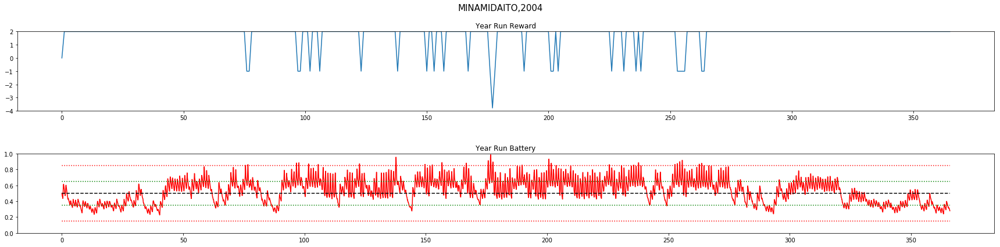

...

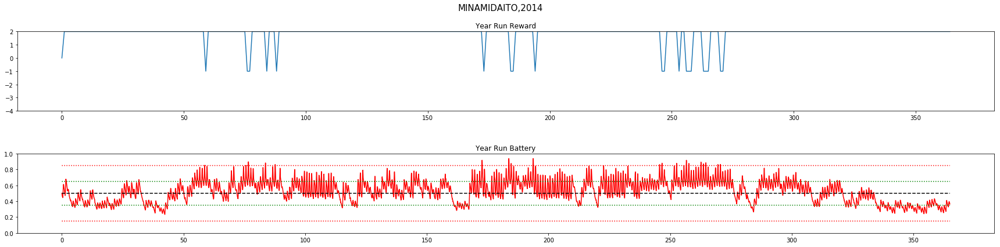

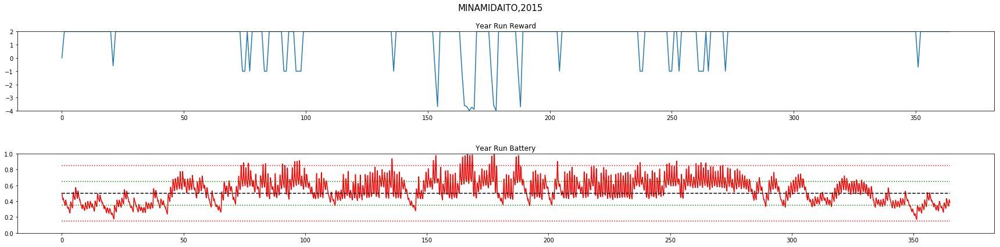

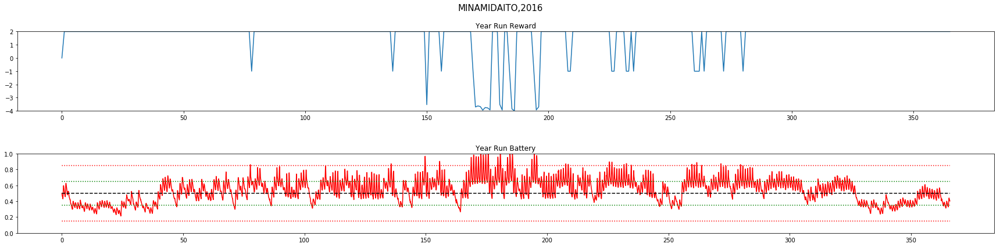

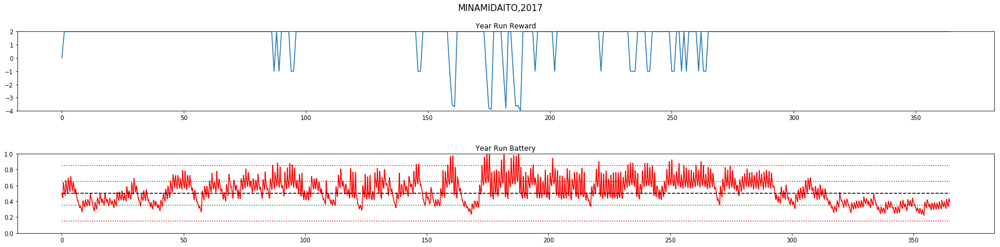

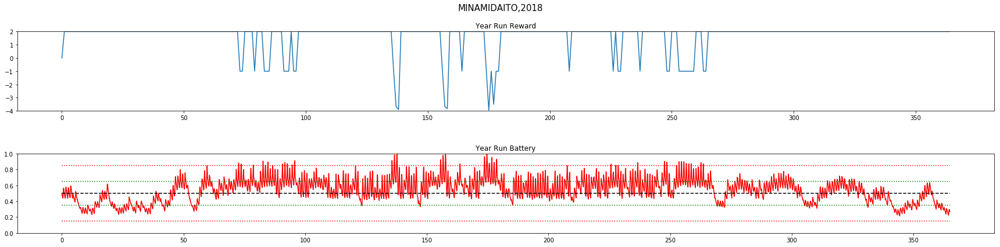



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.83		16	 0
2001	 1.72		28	 0
2002	 1.83		19	 0
2003	 1.62		35	 3
2004	 1.75		29	 0
2005	 1.8		21	 0
2006	 1.7		29	 2
2007	 1.77		21	 3
2008	 1.78		23	 0
2009	 1.76		24	 0
2010	 1.72		24	 2
2011	 1.67		31	 2
2012	 1.74		23	 31
2013	 1.84		15	 0
2014	 1.83		20	 0
2015	 1.62		35	 2
2016	 1.62		33	 4
2017	 1.66		33	 1
2018	 1.62		40	 4

TOTAL Day Violations:   499.0
TOTAL Batt Violations:  54.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:28:10.590542


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

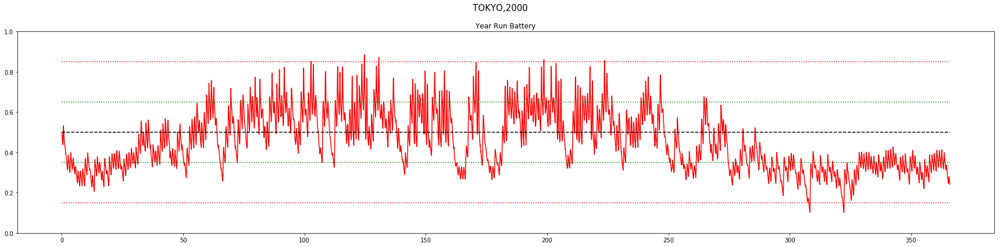

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

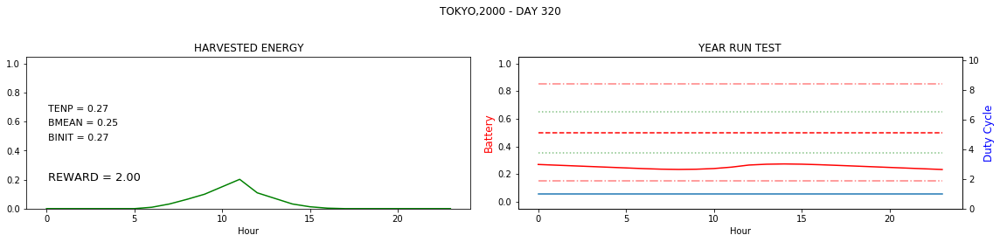

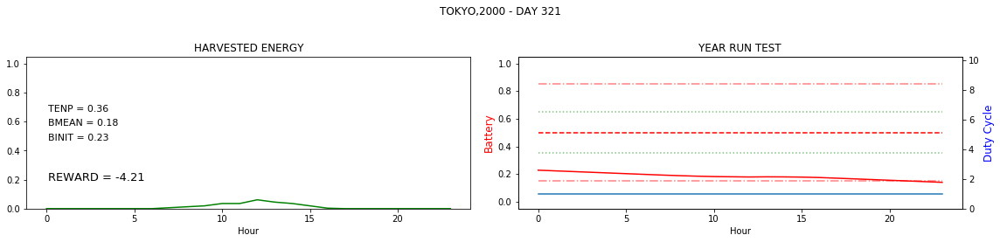

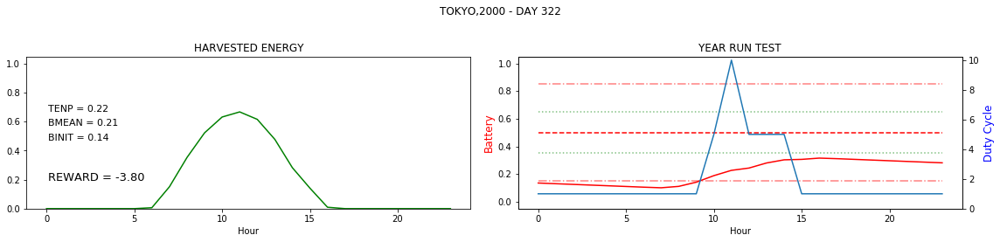

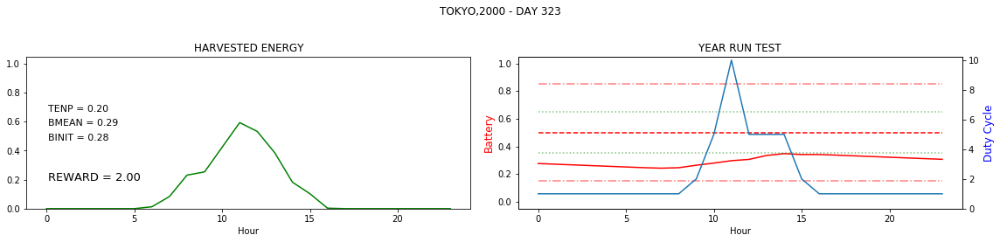

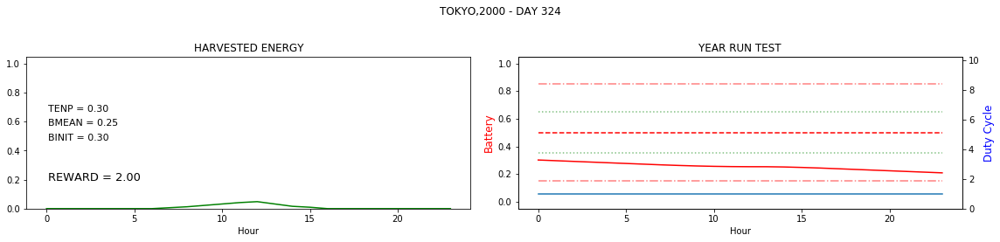

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()